# Original file: bladder_total_combat_clustering_proj_01_Tcellonly.py

In [1]:
import time
import numpy as np
import pandas as pd
import scanpy as sc
import anndata as ad
from scipy.sparse import csr_matrix
import logging
import glob

import matplotlib.pyplot as plt
import matplotlib.axes as axes

#For CLR of ADTs
import scipy
import scipy.stats
from sklearn.preprocessing import scale
import os

sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)

print('Loaded libraries')
sc.logging.print_versions() 
sc.settings.set_figure_params(dpi=100, dpi_save = 1000)


/wynton/home/kimlab/hyang7/miniconda3/lib/python3.7/site-packages/anndata/core/anndata.py:17: FutureWarning: pandas.core.index is deprecated and will be removed in a future version.  The public classes are available in the top-level namespace.
  from pandas.core.index import RangeIndex


Loaded libraries
scanpy==1.4.4.post1 anndata==0.6.22.post1 umap==0.3.10 numpy==1.18.1 scipy==1.4.1 pandas==1.0.3 scikit-learn==0.22.1 statsmodels==0.11.1 python-igraph==0.8.0 louvain==0.6.1


In [2]:
# h5ad_files = glob.glob("/wynton/group/fong/hyang7/bladder_blood_analysis/obj/preprocessing/*.h5ad")

# keep_var = None

# adata_collection = []
# for index in range(0,len(h5ad_files)):
#     print("Reading in {}".format(h5ad_files[index]))
    
#     temp_adata = sc.read(h5ad_files[index])
#     adata_collection.append(temp_adata)
#     if keep_var is None:
#         keep_var = temp_adata.var
#     del temp_adata

# print(adata_collection)

# adata = adata_collection[0]
# for index in range(1, len(adata_collection)):
#     adata = adata.concatenate(adata_collection[index], join = 'outer')
# adata.var = keep_var
# print(adata)


In [3]:
## remove mono cell barcodes
nonTcell_barcodes = np.load("/wynton/group/fong/hyang7/bladder_blood_analysis/filter_barcodes/bladder_total_mono_barcodes.npy", allow_pickle = True)

path = "/wynton/group/fong/hyang7/bladder_blood_analysis/obj/"
adata_file = path + "bladder_total_adata_multiplex_preprocess.h5ad"
#adata.write(adata_file, compression = "gzip")
adata = sc.read(adata_file)
print(adata)


AnnData object with n_obs × n_vars = 157054 × 2028 
    obs: 'RBC', 'batch', 'comp', 'n_counts', 'n_genes', 'patient', 'percent_mito', 'platelet', 'sample', 'tissue', 'treatment', 'louvain', 'leiden'
    var: 'gene_ids', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'leiden', 'louvain', 'neighbors', 'pca'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'


In [ ]:
adata.obs

In [4]:
#Remove nonTcells
adata = adata[[x not in nonTcell_barcodes for x in adata.obs.index]]

percent_mito_cutoff = .10
max_genes_cutoff = 2500

In [5]:
#Keep the count data in a counts layer
adata.layers["counts"] = adata.X.copy()

In [6]:
#Filter cells by cells with min_genes > 100 and genes that appear in at least 3 cells
sc.pp.filter_cells(adata, min_genes=100)
sc.pp.filter_genes(adata, min_cells=3)
before_mito = adata.X.shape[0]

filtered out 267 cells that haveless than 100 genes expressed
filtered out 12729 genes that are detectedin less than 3 cells


In [7]:
#Filter cells by cells with % mito
adata = adata[adata.obs['percent_mito'] < percent_mito_cutoff, :]
print("Dead cells removed: ", before_mito - adata.X.shape[0])
adata = adata[adata.obs['RBC'] == False]
adata = adata[adata.obs['platelet'] == False]

Dead cells removed:  1072


In [8]:
# Filter cells with abnormally high gene counts.
sc.pp.filter_cells(adata, max_genes=max_genes_cutoff)


filtered out 336 cells that havemore than 2500 genes expressed


Trying to set attribute `.obs` of view, making a copy.


In [9]:
#Normalize gene counts
sc.pp.normalize_total(adata, target_sum=1e4)
#Log transform the data
sc.pp.log1p(adata)
#Store raw data
adata.raw = adata


Normalizing counts per cell.
    finished (0:00:00):normalized adata.X


In [11]:
path = "/wynton/group/fong/hyang7/bladder_blood_analysis/obj/"
adata_file = path + "bladder_total_adata_multiplex_Tcellonly.h5ad"
adata.write(adata_file)

In [10]:
sample_id = adata.obs['sample'].tolist()
batch_id = {value:key for key, value in list(enumerate(set(sample_id)))}
batch = [str(batch_id[x]) for x in sample_id]
adata.obs['batch'] = np.array(batch)
print(adata)


AnnData object with n_obs × n_vars = 157054 × 20009 
    obs: 'RBC', 'batch', 'comp', 'n_counts', 'n_genes', 'patient', 'percent_mito', 'platelet', 'sample', 'tissue', 'treatment'
    var: 'gene_ids', 'n_cells'


In [11]:
#Find highly variable genes
sc.pp.highly_variable_genes(adata)
#Filter to highly variable genes
adata = adata[:, adata.var['highly_variable']]

extracting highly variable genes
    finished (0:00:05)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [12]:
#remove_genes = list()
#for gene in adata.var.index:
#    if "TotalSeqC" in gene:
#        remove_genes.append(gene)
#adata = adata[:, [x not in remove_genes for x in adata.var.index]]
sc.pp.regress_out(adata, ['n_counts', 'percent_mito'])

regressing out ['n_counts', 'percent_mito']
    sparse input is densified and may lead to high memory use


Trying to set attribute `.obs` of view, making a copy.
... storing 'batch' as categorical


    finished (0:02:45)


In [13]:
sc.pp.combat(adata, key='batch', inplace=True)

print("Finished combat")

print(adata)

Standardizing Data across genes.

Found 27 batches

Found 0 numerical variables:
	

Fitting L/S model and finding priors

Finding parametric adjustments



/wynton/home/kimlab/hyang7/miniconda3/lib/python3.7/site-packages/scanpy/preprocessing/_combat.py:269: NumbaWarning: 
Compilation is falling back to object mode WITH looplifting enabled because Function "_it_sol" failed type inference due to: Cannot unify array(float64, 2d, C) and array(float64, 1d, C) for 'sum2', defined at /wynton/home/kimlab/hyang7/miniconda3/lib/python3.7/site-packages/scanpy/preprocessing/_combat.py (311)

File "../../../../../home/kimlab/hyang7/miniconda3/lib/python3.7/site-packages/scanpy/preprocessing/_combat.py", line 311:
def _it_sol(s_data, g_hat, d_hat, g_bar, t2, a, b, conv=0.0001) -> Tuple[float, float]:
    <source elided>
        g_new = (t2*n*g_hat + d_old*g_bar) / (t2*n + d_old)
        sum2 = s_data - g_new.reshape((g_new.shape[0], 1)) @ np.ones((1, s_data.shape[1]))
        ^

[1] During: typing of assignment at /wynton/home/kimlab/hyang7/miniconda3/lib/python3.7/site-packages/scanpy/preprocessing/_combat.py (313)

File "../../../../../home/kimlab/h

Adjusting data

Finished combat
AnnData object with n_obs × n_vars = 157054 × 2028 
    obs: 'RBC', 'batch', 'comp', 'n_counts', 'n_genes', 'patient', 'percent_mito', 'platelet', 'sample', 'tissue', 'treatment'
    var: 'gene_ids', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'


In [14]:
sc.pp.scale(adata, max_value=10)

In [15]:
# Set seed
intialization = 42

os.chdir("/wynton/group/fong/hyang7/bladder_blood_analysis/plots/")
print(os.getcwd())

/wynton/group/fong/hyang7/bladder_blood_analysis/plots


In [16]:
# Run louvain clustering on theoretical future gene expression per cell
sc.pp.pca(adata, random_state=intialization, svd_solver='arpack')
sc.pl.pca_variance_ratio(adata, n_pcs= 50, log=True, show = False, save = "_pca_ratio.pdf")


computing PCA with n_comps = 50
computing PCA on highly variable genes
    finished (0:04:52)


In [17]:
sc.pp.neighbors(adata, random_state=intialization)
sc.tl.louvain(adata, random_state=intialization, resolution = 0.9)
sc.tl.leiden(adata, random_state=intialization, resolution = 0.9)
sc.tl.umap(adata, random_state=intialization)


computing neighbors
    using 'X_pca' with n_pcs = 50


/wynton/home/kimlab/hyang7/miniconda3/lib/python3.7/site-packages/numba/typed_passes.py:293: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../home/kimlab/hyang7/miniconda3/lib/python3.7/site-packages/umap/rp_tree.py", line 135:
@numba.njit(fastmath=True, nogil=True, parallel=True)
def euclidean_random_projection_split(data, indices, rng_state):
^

  state.func_ir.loc))
/wynton/home/kimlab/hyang7/miniconda3/lib/python3.7/site-packages/umap/nndescent.py:92: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../

    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:01:41)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 10 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:34)
running Leiden clustering
    finished: found 11 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:04:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:04:15)


In [18]:
adata.write(adata_file, compression = "gzip")
print(adata)


AnnData object with n_obs × n_vars = 157054 × 2028 
    obs: 'RBC', 'batch', 'comp', 'n_counts', 'n_genes', 'patient', 'percent_mito', 'platelet', 'sample', 'tissue', 'treatment', 'louvain', 'leiden'
    var: 'gene_ids', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'pca', 'neighbors', 'louvain', 'leiden'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'


In [19]:
sc.pl.umap(adata, color=['louvain'],legend_loc = 'on data', show = False, save = '_louvain_on_data.pdf')
sc.pl.umap(adata, color=['louvain'], show = False, save = '_louvain.pdf')
sc.pl.umap(adata, color=['leiden'],legend_loc = 'on data', show = False, save = '_leiden_on_data.pdf')
sc.pl.umap(adata, color=['leiden'],  show = False, save = '_leiden.pdf')
sc.pl.umap(adata, color=['batch'],  show = False, save = '_batch.pdf')


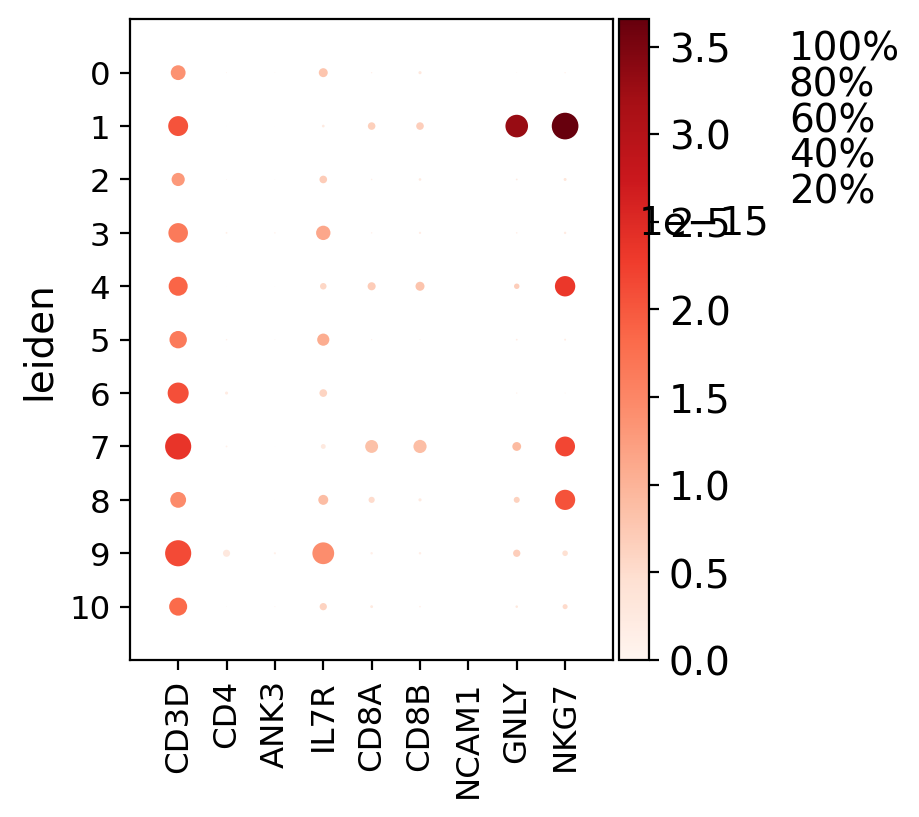

/wynton/home/kimlab/hyang7/miniconda3/lib/python3.7/site-packages/anndata/core/anndata.py:299: FutureWarning: In anndata v0.7+, arrays contained within an AnnData object will maintain their dimensionality. For example, prior to v0.7 `adata[0, 0].X` returned a scalar and `adata[0, :]` returned a 1d array, post v0.7 they will return two dimensional arrays. If you would like to get a one dimensional array from your AnnData object, consider using the `adata.obs_vector`, `adata.var_vector` methods or accessing the array directly.
  warn_flatten()


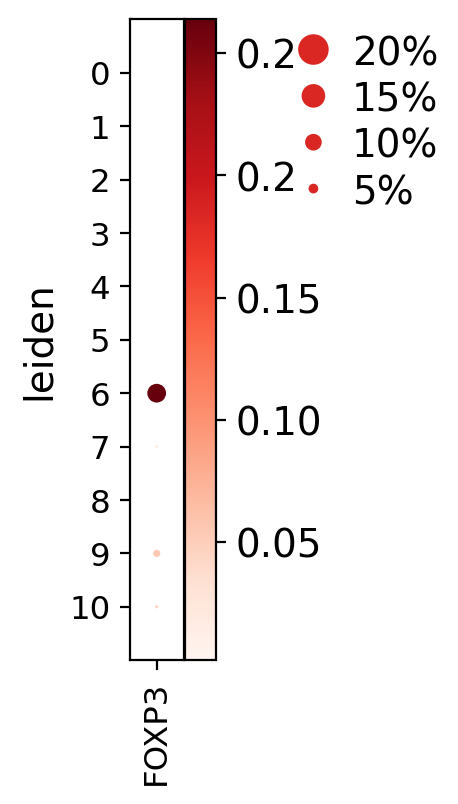

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[0.35, 0, 0.2, 0.5, 0.25])

In [20]:
marker_genes = ['CD3D', 'CD4',
                         'ANK3',
                         'IL7R',
                         'CD8A',
                         'CD8B','NCAM1','GNLY','NKG7']
sc.pl.dotplot(adata, marker_genes, groupby='leiden', use_raw = True,  save = '_CD3_dotplot.pdf')
sc.pl.dotplot(adata, ['FOXP3'], groupby='leiden', use_raw = True,  save = '_foxp3_dotplot.pdf')


In [21]:
# adata = sc.read(adata_file)
# print(adata)


In [22]:
sample_id = adata.obs['sample'].tolist()
batch_id = {value:key for key, value in list(enumerate(set(sample_id)))}
batch = [str(batch_id[x]) for x in sample_id]
print(batch_id)
batch_df = pd.DataFrame(list(batch_id.items()))
batch_df.columns = ['sample','batch_id']
batch_df.to_csv("/wynton/group/fong/hyang7/bladder_blood_analysis/metadata/batch_match_filtered.csv", index = False)
# adata.obs['batch'] = np.array(batch)
# print(adata)


{'atezo4_post': 0, 's3normal': 1, 'atezo3_post': 2, 'atezo2_pre': 3, 'atezo2': 4, 'a4normal': 5, 'atezo4': 6, 'atezo5': 7, 'soc1': 8, 's1normal': 9, 'h3blood': 10, 'soc2': 11, 'a5normal': 12, 'h1blood': 13, 'atezo5_pre': 14, 's2blood': 15, 'a3normal': 16, 's1blood': 17, 's2normal': 18, 'atezo5_post2': 19, 'atezo2_post': 20, 's3blood': 21, 'atezo4_pre': 22, 'atezo3_pre': 23, 'soc3': 24, 'atezo3': 25, 'h2blood': 26}


In [23]:
# mono_genes = ['CD3D','CD14','FCGR3A','CD68',
#              'CSF3R','HLA-DQA1','FLT3','FCER1A']

# sc.pl.dotplot(adata, mono_genes, groupby='leiden', use_raw = True,  save = '_Mono_leiden_dotplot.pdf')


In [24]:
leiden_prop = dict()
no_clusters = len(adata.obs['leiden'].unique())
for sn in adata.obs['batch'].unique():
   temp = adata[adata.obs['batch'] == sn,:]
   cell_count = temp.obs['leiden'].value_counts()
   cell_count = cell_count.sort_index()
   cell_count = cell_count.to_dict()
   cell_count = [cell_count[str(x)] if str(x) in cell_count.keys() else 0 for x in range(0,no_clusters)]
   leiden_prop[sn] = cell_count


In [25]:
leiden_prop = pd.DataFrame(leiden_prop).T

leiden_prop['total'] = leiden_prop.sum(axis = 1)
leiden_prct = pd.DataFrame()
for x in leiden_prop.columns:
   leiden_prct[x] = leiden_prop[x]/leiden_prop[x].sum()
leiden_prct = leiden_prct.sort_index()


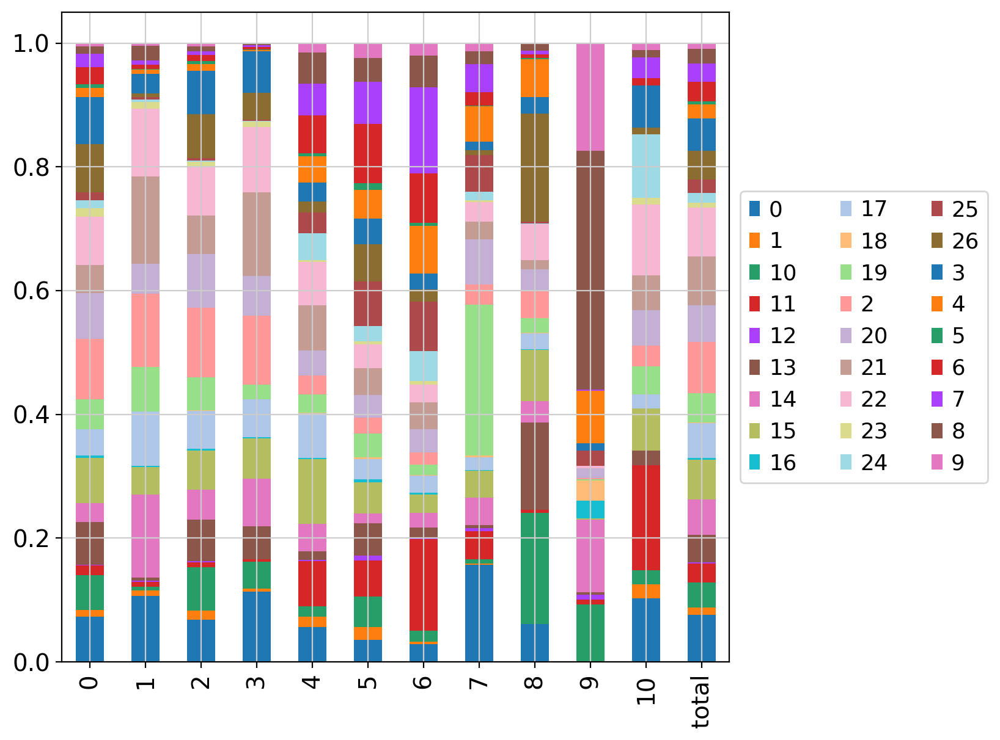

In [26]:
leiden_prct.T.plot.bar(stacked=True, legend = False,figsize=(7,7))
plt.legend(loc='center left', bbox_to_anchor=(1.0, 0.5), ncol = 3)
plt.savefig("/wynton/group/fong/hyang7/bladder_blood_analysis/plots/figures/leidencluster_batch_breakdown.pdf",dpi = 1000, bbox_inches='tight')


# Original code: bladder_extract.py

In [2]:
path = "/wynton/group/fong/hyang7/bladder_blood_analysis/obj/"
adata_file = path + "bladder_total_adata_multiplex_Tcellonly.h5ad"
adata = sc.read(adata_file)
adata

file_path = "/wynton/group/fong/hyang7/bladder_blood_analysis/obj/raw_data/"

adata.obs.to_csv(file_path + "bladder_total_adata_multiplex_Tcellonly_obs_data.csv")

var_genes = list(adata.var.index)

raw_df = pd.DataFrame(adata.raw.X.toarray()).T
raw_df.columns = adata.obs.index
raw_df.index = adata.raw.var_names
raw_df = raw_df[raw_df.index.isin(var_genes)]
raw_df.to_csv(file_path + "bladder_total_adata_multiplex_Tcellonly_raw_var_data.csv")

print("Done!")

Done!


# Original code: bladder_random_extract.py

In [3]:
path = "/wynton/group/fong/hyang7/bladder_blood_analysis/obj/"
adata_file = path + "bladder_total_adata_multiplex_Tcellonly.h5ad"
adata = sc.read(adata_file)
print(adata)

file_path = "/wynton/group/fong/hyang7/bladder_blood_analysis/obj/raw_data/"

indices = list(range(len(adata)))
adata_sublist = np.random.choice(indices, size=10000, replace=False, p=None)
includebarcodes = adata.obs.index[adata_sublist]

adata_sub = adata[adata.obs.index.isin(includebarcodes)]
print(adata_sub)

adata_sub.obs.to_csv(file_path + "bladder_total_adata_multiplex_Tcellonly_obs_data_subset.csv")


raw_df = pd.DataFrame(adata_sub.raw.X.toarray()).T
raw_df.columns = adata_sub.obs.index
raw_df.index = adata_sub.raw.var_names
raw_df.to_csv(file_path + "bladder_total_adata_multiplex_Tcellonly_raw_data_subset.csv")

print("Done!")



AnnData object with n_obs × n_vars = 157054 × 2028 
    obs: 'RBC', 'batch', 'comp', 'n_counts', 'n_genes', 'patient', 'percent_mito', 'platelet', 'sample', 'tissue', 'treatment', 'louvain', 'leiden'
    var: 'gene_ids', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'leiden', 'louvain', 'neighbors', 'pca'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
View of AnnData object with n_obs × n_vars = 10000 × 2028 
    obs: 'RBC', 'batch', 'comp', 'n_counts', 'n_genes', 'patient', 'percent_mito', 'platelet', 'sample', 'tissue', 'treatment', 'louvain', 'leiden'
    var: 'gene_ids', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'leiden', 'louvain', 'neighbors', 'pca'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
Done!


# code: bladder_plotting.py

AnnData object with n_obs × n_vars = 157054 × 2028 
    obs: 'RBC', 'batch', 'comp', 'n_counts', 'n_genes', 'patient', 'percent_mito', 'platelet', 'sample', 'tissue', 'treatment', 'louvain', 'leiden'
    var: 'gene_ids', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'leiden', 'louvain', 'neighbors', 'pca'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
/wynton/group/fong/hyang7/bladder_blood_analysis/plots
computing density on 'umap'
--> added
    'umap_density_comp', densities (adata.obs)
    'umap_density_comp_params', parameter (adata.uns)


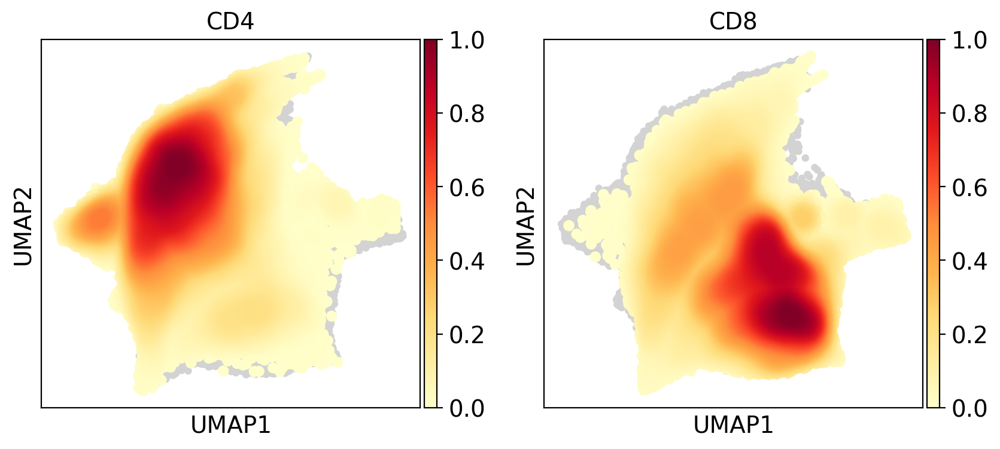

computing density on 'umap'
--> added
    'umap_density_treatment', densities (adata.obs)
    'umap_density_treatment_params', parameter (adata.uns)


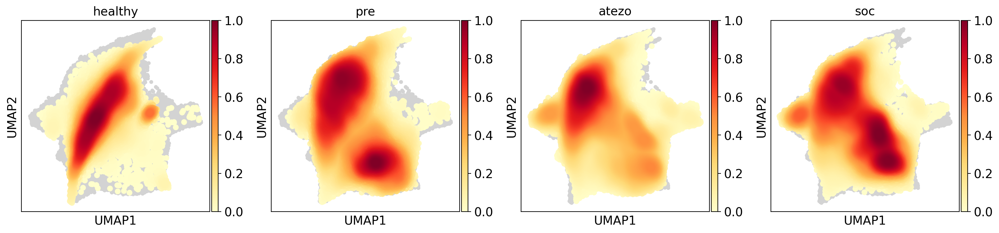

computing density on 'umap'
--> added
    'umap_density_tissue', densities (adata.obs)
    'umap_density_tissue_params', parameter (adata.uns)


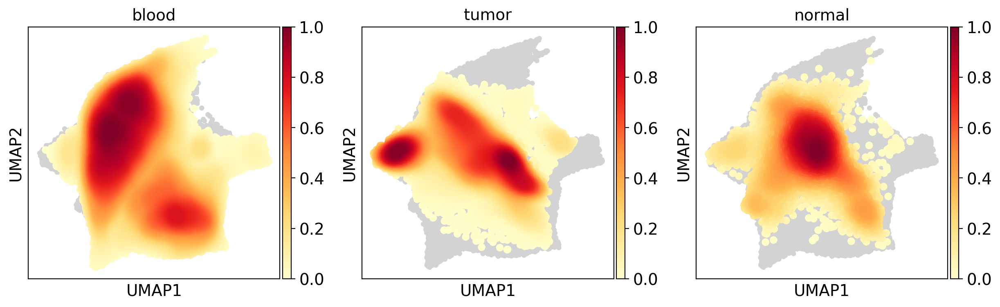

In [5]:
path = "/wynton/group/fong/hyang7/bladder_blood_analysis/obj/"
adata_file = path + "bladder_total_adata_multiplex_Tcellonly.h5ad"
adata = sc.read(adata_file)
print(adata)

os.chdir("/wynton/group/fong/hyang7/bladder_blood_analysis/plots/")
print(os.getcwd())

sc.tl.embedding_density(adata, basis='umap', groupby='comp')
sc.pl.embedding_density(adata, basis='umap',key = 'umap_density_comp', group = ['CD4','CD8'],
                        save = "TcellOnly.pdf")

sc.tl.embedding_density(adata, basis='umap', groupby='treatment')
sc.pl.embedding_density(adata, basis='umap',key = 'umap_density_treatment', group = ['healthy','pre','atezo','soc'],
                        save = "TcellOnly.pdf")

sc.tl.embedding_density(adata, basis='umap', groupby='tissue')
sc.pl.embedding_density(adata, basis='umap',key = 'umap_density_tissue', group = ['blood','tumor','normal'],
                        save = "TcellOnly.pdf")



# code: bladder_Totalanalysis.ipynb

In [3]:
os.chdir("/wynton/group/fong/hyang7/bladder_blood_analysis/plots/")
print(os.getcwd())

/wynton/group/fong/hyang7/bladder_blood_analysis/plots


In [4]:
path = "/wynton/group/fong/hyang7/bladder_blood_analysis/obj/"
adata_file = path + "bladder_total_adata_multiplex_Tcellonly.h5ad"
# run this code to load data
adata = sc.read(adata_file)
adata

AnnData object with n_obs × n_vars = 157054 × 2028 
    obs: 'RBC', 'batch', 'comp', 'n_counts', 'n_genes', 'patient', 'percent_mito', 'platelet', 'sample', 'tissue', 'treatment', 'louvain', 'leiden', 'umap_density_comp', 'umap_density_treatment', 'umap_density_tissue', 'cell_calls', 'S_score', 'G2M_score', 'phase'
    var: 'gene_ids', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'batch_colors', 'cell_calls_colors', 'comp_colors', 'dendrogram_cell_calls', 'leiden', 'leiden_colors', 'louvain', 'louvain_colors', 'neighbors', 'pca', 'phase_colors', 'tissue_colors', 'treatment_colors', 'umap_density_comp_params', 'umap_density_tissue_params', 'umap_density_treatment_params'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'

In [5]:
tissue_color = ['coral','cornflowerblue','#D11141']
cell_comp_color = ['#619CFF','#00BA38']
treatment_color = ['#f37735','aquamarine','#00aedb','darkseagreen']
til_treatment_color = ['#f37735','darkseagreen']

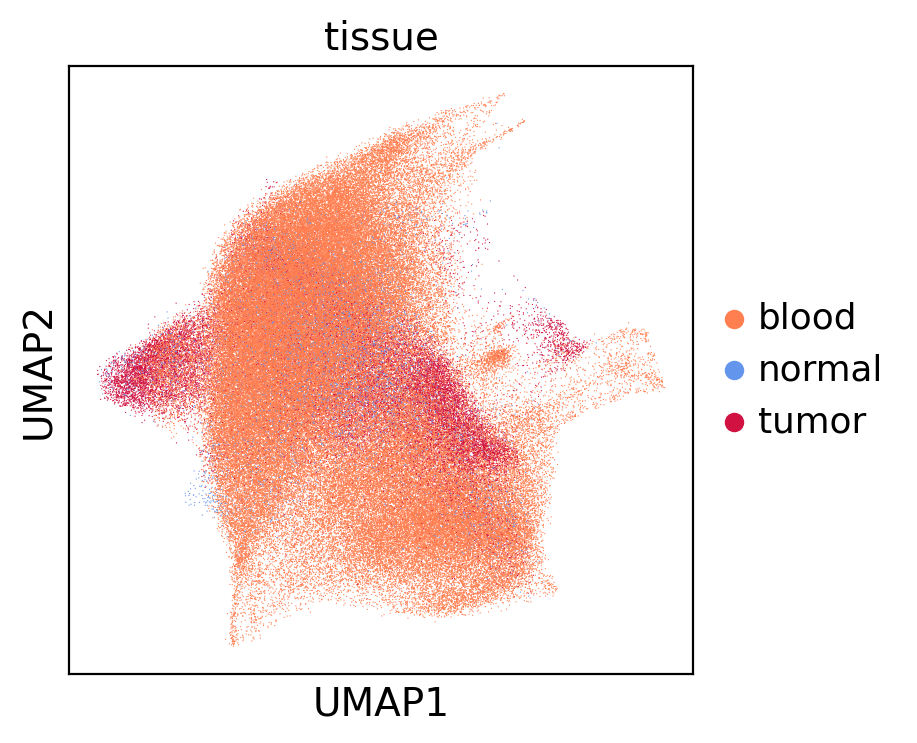

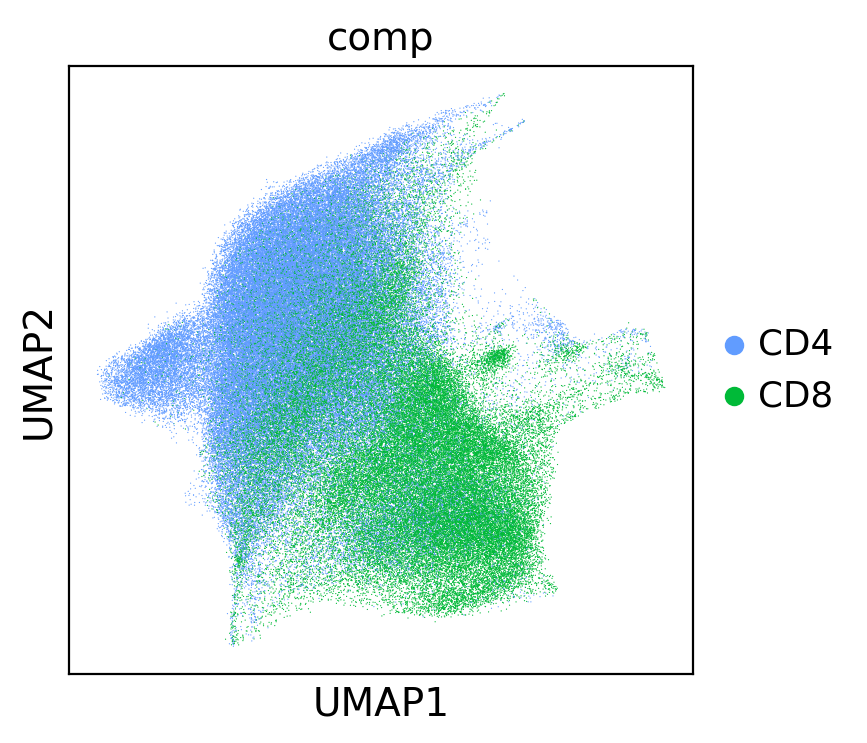

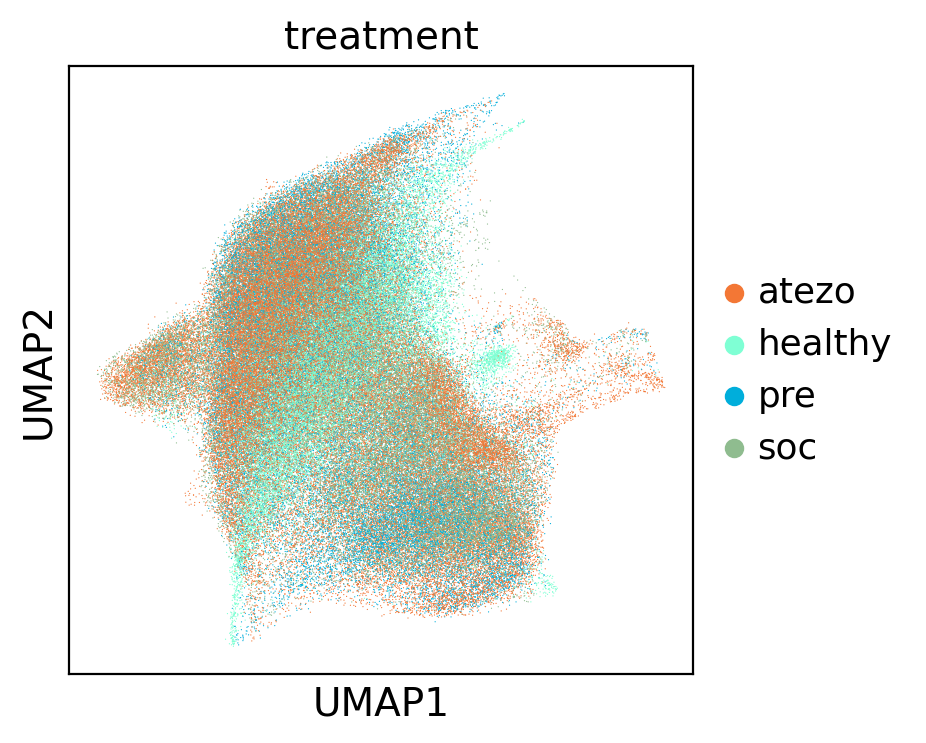

In [6]:
sc.pl.umap(adata, color = "tissue", palette=['coral','cornflowerblue','#D11141'], save = "_tissue.pdf")
sc.pl.umap(adata, color = "comp", palette = ['#619CFF','#00BA38'], save = "_comp.pdf")
sc.pl.umap(adata, color = "treatment", 
           palette = ['#f37735','aquamarine','#00aedb','darkseagreen'],
           save = "_treatment.pdf")

In [7]:
markers = ["CD4","CD8A","IL7R",
           "FOXP3",'IL2RA','CCR7','SELL','CREM',
            "RORC",'NKG7',"GNLY",'PRF1',
            "GZMA",'GZMB','GZMH',"GZMK",
            "GZMM",'IFNG','MKI67','CTLA4',
           'TOX','TIGIT','PDCD1','LAG3','SLC4A10']

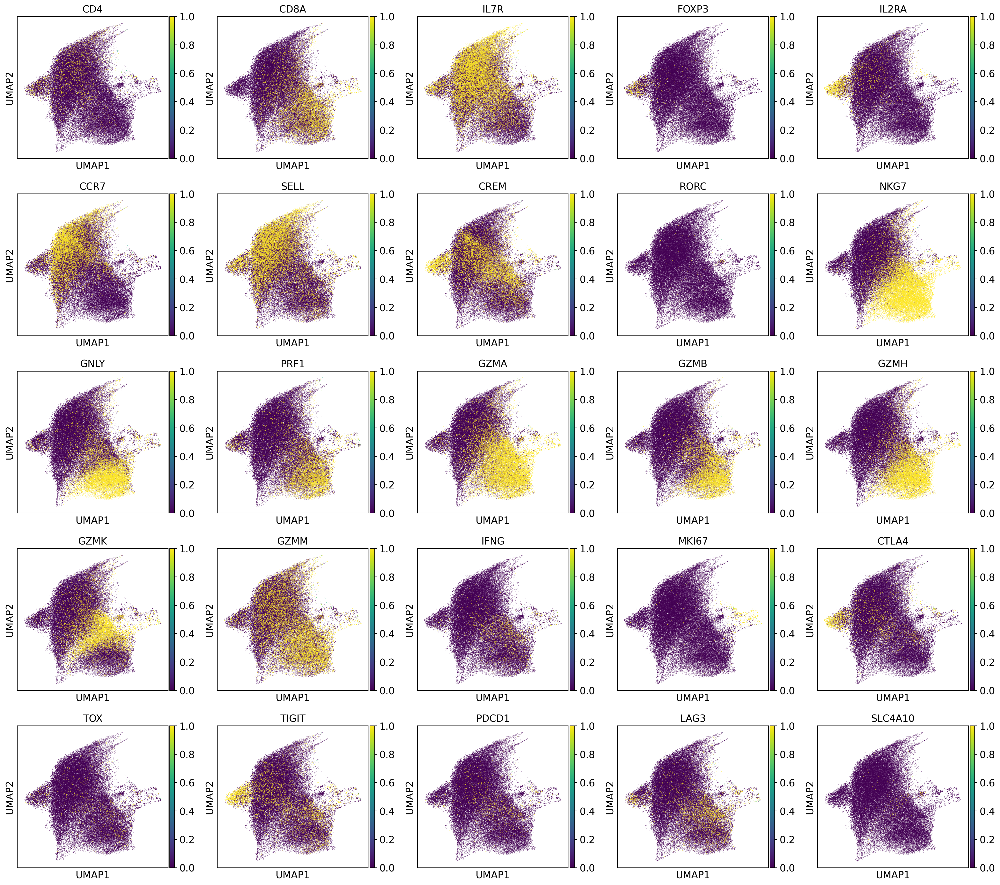

In [8]:
sc.pl.umap(adata, color =markers, ncols = 5, vmin = 0, vmax = 1,
           save = "_cellmarkers_TcellOnly.pdf")

In [11]:
markers = ["ENTPD1","ITGAE","KLRG1","GZMK", "GZMB", "PRF1"]

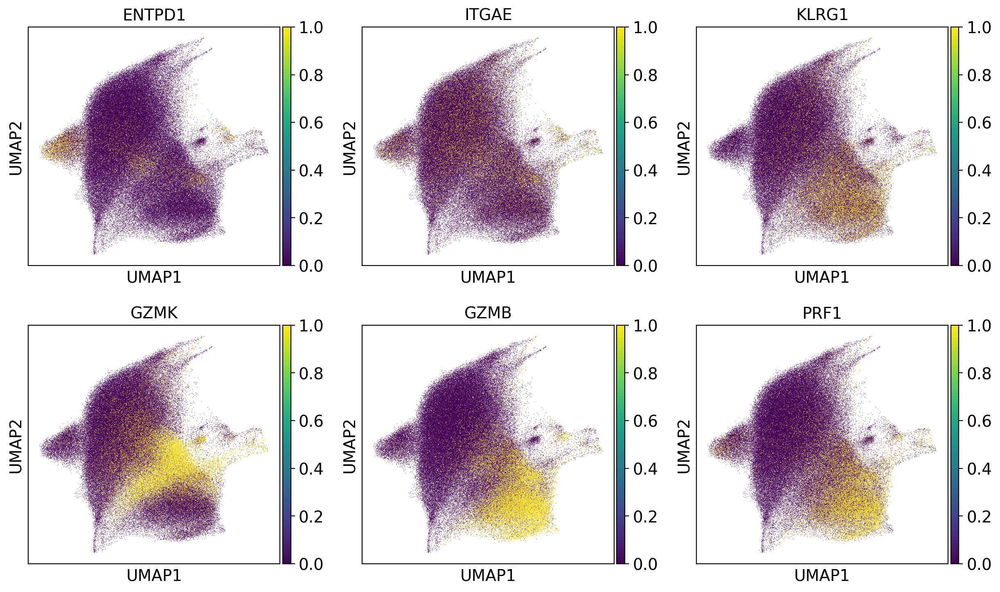

In [12]:
sc.pl.umap(adata, color =markers, ncols = 3, vmin = 0, vmax = 1)

In [10]:
leiden_prop = dict()
blood_adata = adata#[adata.obs['tissue'].isin(['blood'])]
# new_treatment = ['pre' if x == 'soc' else x for x in blood_adata.obs['treatment'].tolist()]
# blood_adata.obs['treatment'] = new_treatment

no_clusters = sorted(blood_adata.obs['leiden'].unique())
for sn in blood_adata.obs['tissue'].unique():
    temp = blood_adata[blood_adata.obs['tissue'] == sn,:]
    cell_count = temp.obs['leiden'].value_counts()
    cell_count = cell_count.sort_index()
    cell_count = cell_count.to_dict()
    cell_count = [cell_count[str(x)] if str(x) in cell_count.keys() else 0 for x in no_clusters]
    leiden_prop[sn] = cell_count
    del temp

leiden_prop = pd.DataFrame(leiden_prop)
leiden_prop.index = no_clusters
leiden_prop = leiden_prop.T
leiden_prop

,0,1,10,2,3,4,5,6,7,8,9
tumor,4088,1664,29,1145,391,6874,6964,5471,636,155,262
normal,949,494,3,734,201,798,1216,317,61,9,126
blood,29722,25241,56,21718,20655,11699,9030,2989,1711,1516,130


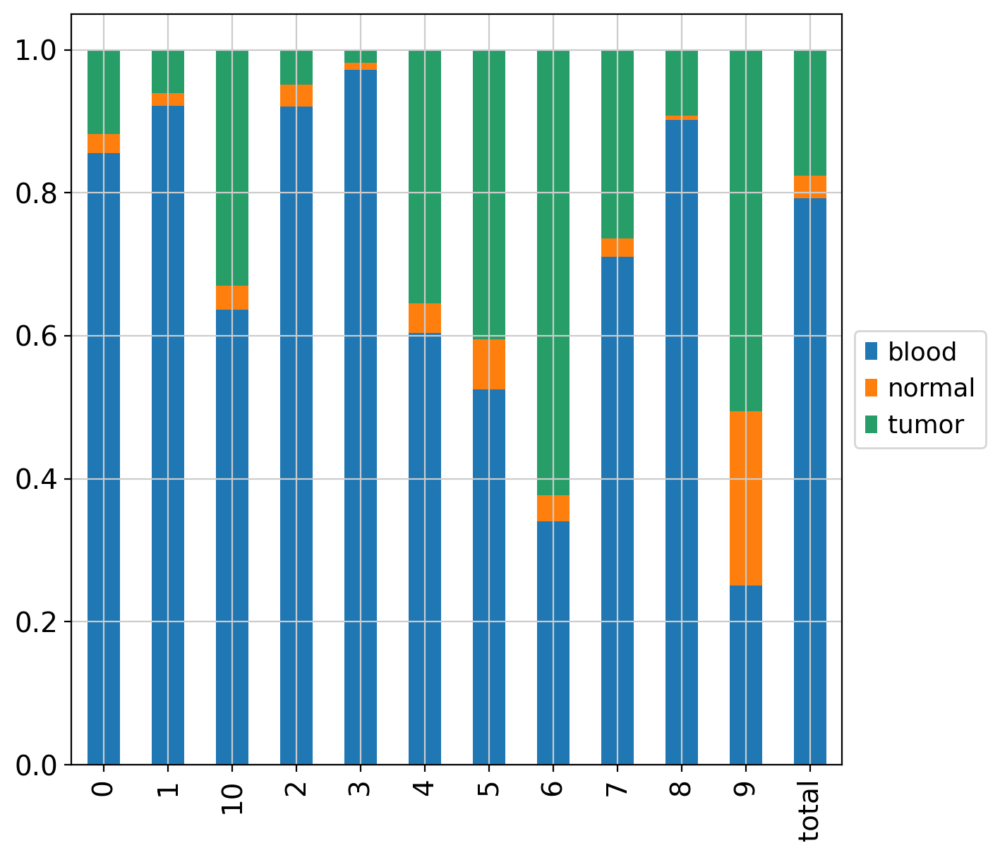

In [11]:
leiden_prop['total'] = leiden_prop.sum(axis = 1)
leiden_prct = pd.DataFrame()
for x in leiden_prop.columns:
    leiden_prct[x] = leiden_prop[x]/leiden_prop[x].sum()
leiden_prct = leiden_prct.sort_index()

leiden_prct.T.plot.bar(stacked=True, legend = False,figsize=(7,7))
plt.legend(loc='center left', bbox_to_anchor=(1.0, 0.5), ncol = 1)
plt.savefig("/wynton/group/fong/hyang7/bladder_blood_analysis/plots/figures/bladder_TcellOnly/TissueSortcluster_batch_breakdown.pdf",
            dpi = 1000, bbox_inches='tight')

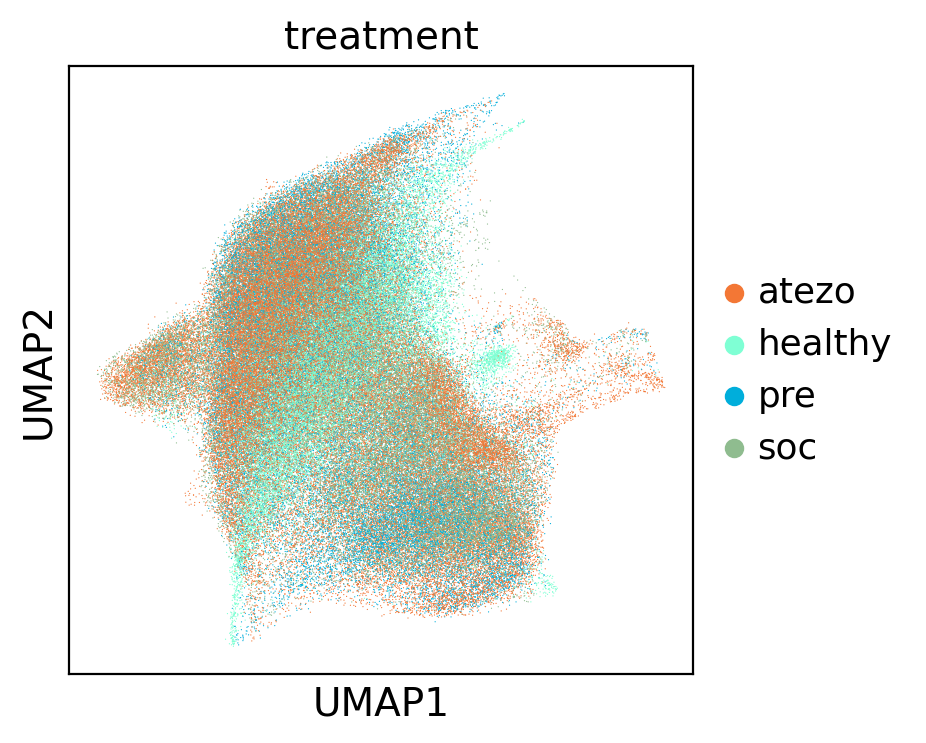

In [12]:
#blood_adata = adata[adata.obs['tissue'] == 'blood']
#new_treatment = ['pre' if x == 'soc' else x for x in blood_adata.obs['treatment'].tolist()]
#blood_adata.obs['treatment'] = new_treatment
sc.pl.umap(blood_adata, color = ['treatment'], save = "_treatment_blood.pdf")

In [13]:
cell_calls = {'0':'Naive','1':'GZMB+','2':'Mito','3':'CM',
              '4':'GZMK+','5':'CXCL13+','6':'Tregs',
              '7':'Prolif GZMK+','8':'MAIT',
              '9':'Activated','10':'IFN+'}

adata.obs['cell_calls'] = adata.obs['leiden'].map(cell_calls)
adata.write(adata_file, compression = 'gzip')

In [14]:
file_path = "/wynton/group/fong/hyang7/bladder_blood_analysis/obj/raw_data/"

adata.obs.to_csv(file_path + "bladder_total_adata_multiplex_Tcellonly_obs_data.csv")

In [15]:
adata.obs['cell_calls'].value_counts()

Naive           34759
GZMB+           27399
Mito            23597
CM              21247
GZMK+           19371
CXCL13+         17210
Tregs            8777
Prolif GZMK+     2408
MAIT             1680
Activated         518
IFN+               88
Name: cell_calls, dtype: int64

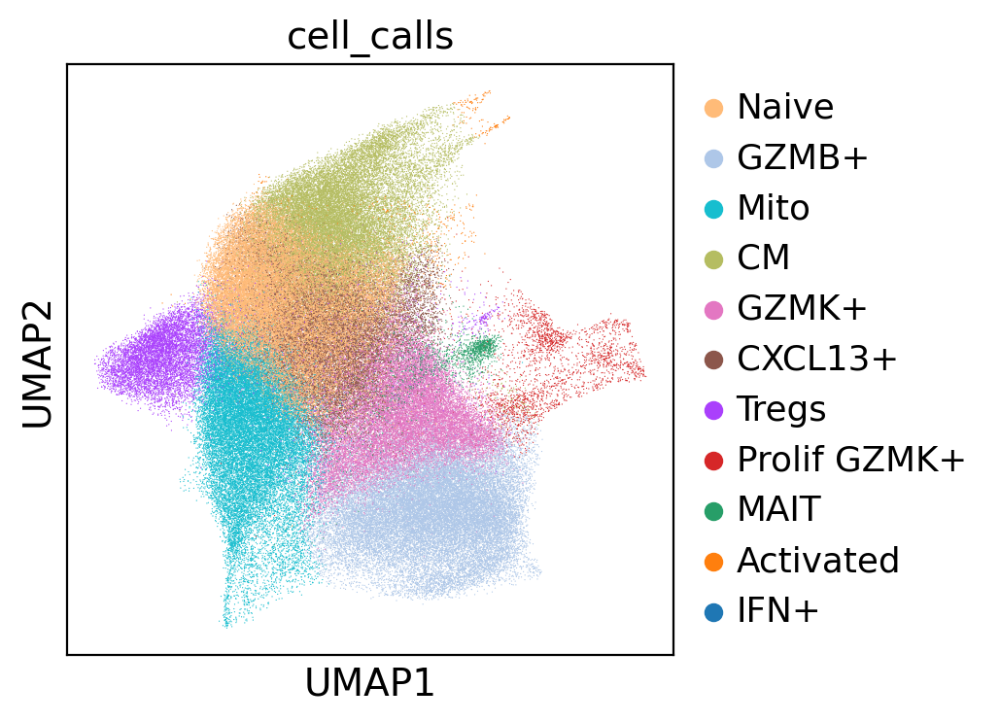

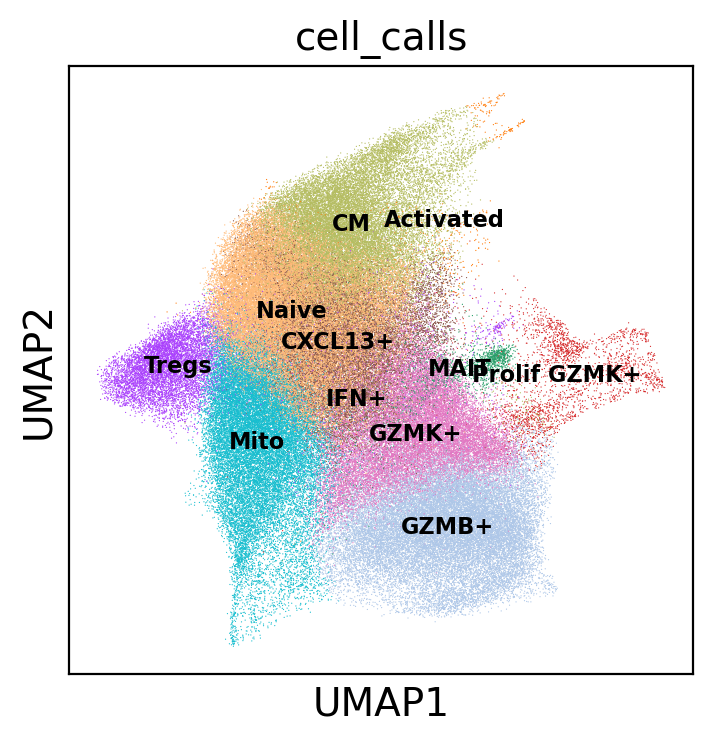

In [20]:
umap_colors = ['#ffbb78',
 '#aec7e8',
 '#17becf',
 '#b5bd61',
 '#e377c2',
 '#8c564b',
 '#aa40fc',
 '#d62728',
 '#279e68',
 '#ff7f0e',
 '#1f77b4']

umap_order = ['Naive','GZMB+','Mito','CM','GZMK+',
             'CXCL13+','Tregs','Prolif GZMK+',
             'MAIT','Activated','IFN+']
umap_dict = dict(zip(umap_order,umap_colors))

sc.pl.umap(adata, color = "cell_calls", palette = umap_colors , save = "_cellcalls.pdf")
sc.pl.umap(adata, color = ['cell_calls'], legend_loc = 'on data', legend_fontsize = 'xx-small',
          palette = umap_colors, save = '_cellcalls_on_data.pdf')

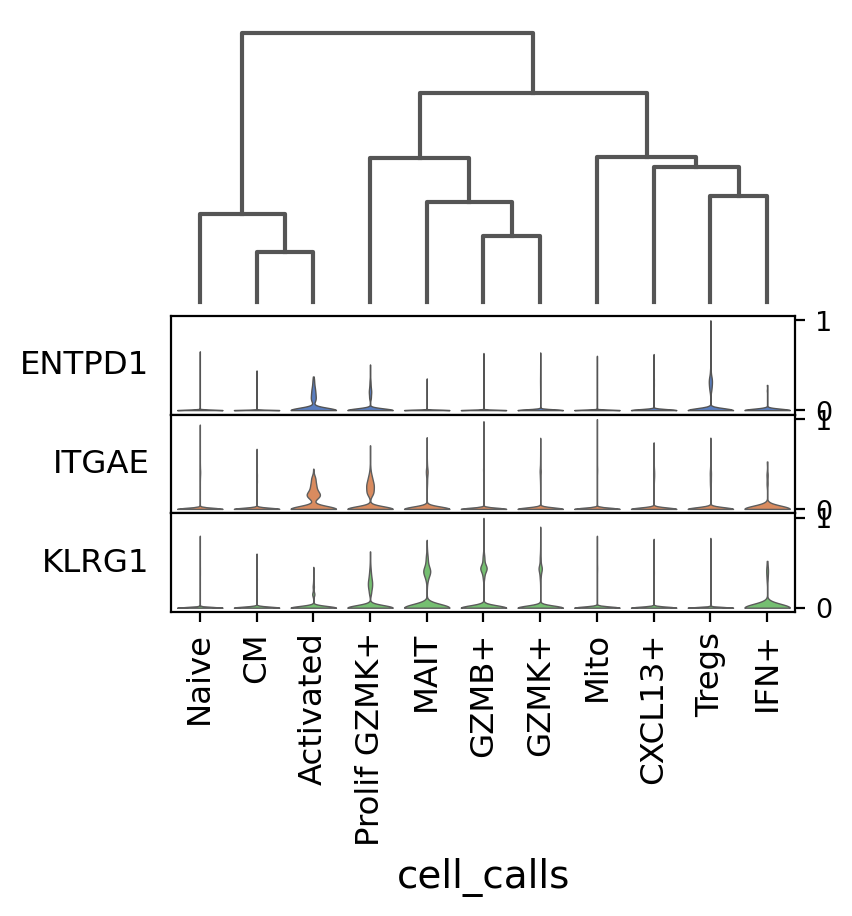

In [17]:
sc.pl.stacked_violin(adata, markers, groupby="cell_calls", 
                     use_raw = True, swap_axes = True, standard_scale = 'var',
                     save = "_cellcalls_cellmarkers.pdf", dendrogram=True)

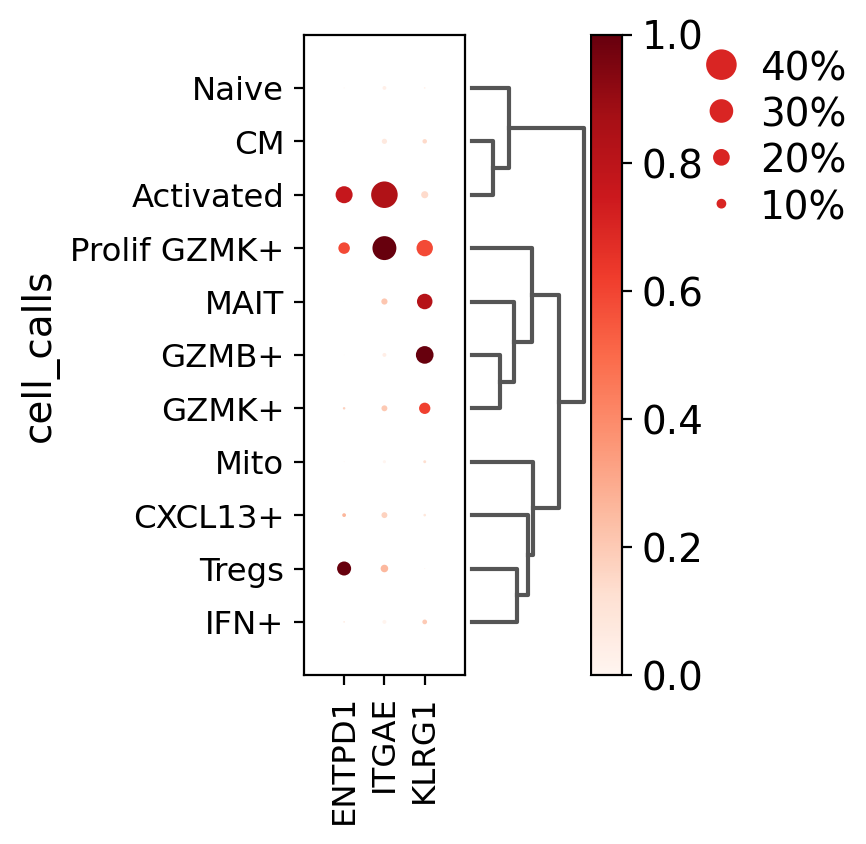

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[1.0499999999999998, 0.8, 0.2, 0.5, 0.25])

In [18]:
sc.pl.dotplot(adata, markers, groupby='cell_calls', use_raw = True, standard_scale='var',
              dendrogram = True, save = "_cellmarkers_cellcalls.pdf")

In [19]:
cell_order = ['Naive','CM','Tregs','CXCL13+','Activated',
             'GZMB+','GZMK+','Prolif GZMK+', 
             'MAIT','IFN+','Mito']

In [20]:
adata

AnnData object with n_obs × n_vars = 157054 × 2028 
    obs: 'RBC', 'batch', 'comp', 'n_counts', 'n_genes', 'patient', 'percent_mito', 'platelet', 'sample', 'tissue', 'treatment', 'louvain', 'leiden', 'umap_density_comp', 'umap_density_treatment', 'umap_density_tissue', 'cell_calls', 'S_score', 'G2M_score', 'phase'
    var: 'gene_ids', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'batch_colors', 'cell_calls_colors', 'comp_colors', 'dendrogram_cell_calls', 'leiden', 'leiden_colors', 'louvain', 'louvain_colors', 'neighbors', 'pca', 'phase_colors', 'tissue_colors', 'treatment_colors', 'umap_density_comp_params', 'umap_density_tissue_params', 'umap_density_treatment_params'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'

In [21]:
color_dict = dict(zip(adata.obs['cell_calls'].unique(), adata.uns['cell_calls_colors']))
color_order = []
for x in cell_order:
    color_order.append(color_dict[x])
color_order

['#ffbb78',
 '#aa40fc',
 '#17becf',
 '#aec7e8',
 '#1f77b4',
 '#b5bd61',
 '#e377c2',
 '#d62728',
 '#ff7f0e',
 '#279e68',
 '#8c564b']

In [22]:
leiden_prop = dict()
blood_adata = adata[adata.obs['tissue'].isin(['blood'])]
# new_treatment = ['pre' if x == 'soc' else x for x in blood_adata.obs['treatment'].tolist()]
# blood_adata.obs['treatment'] = new_treatment

no_clusters = sorted(blood_adata.obs['cell_calls'].unique())
for sn in blood_adata.obs['treatment'].unique():
#   temp = blood_adata[blood_adata.obs['treatment'] == sn,:]
    temp = blood_adata[blood_adata.obs['treatment'] == sn]
    cell_count = temp.obs['cell_calls'].value_counts()
    cell_count = cell_count.sort_index()
    cell_count = cell_count.to_dict()
    cell_count = [cell_count[str(x)] if str(x) in cell_count.keys() else 0 for x in no_clusters]
    leiden_prop[sn] = cell_count
    del temp

leiden_prop = pd.DataFrame(leiden_prop)
leiden_prop.index = no_clusters
leiden_prop = leiden_prop.T
leiden_prop = leiden_prop[cell_order]
leiden_prop

,Naive,CM,Tregs,CXCL13+,Activated,GZMB+,GZMK+,Prolif GZMK+,MAIT,IFN+,Mito
soc,5587,5552,880,2164,1,7502,4838,223,207,13,4419
atezo,10177,6655,906,2350,10,9461,3038,1218,276,21,7555
healthy,7087,2970,466,2781,50,475,938,46,831,5,4912
pre,6871,5478,737,1735,69,7803,2885,224,202,17,4832


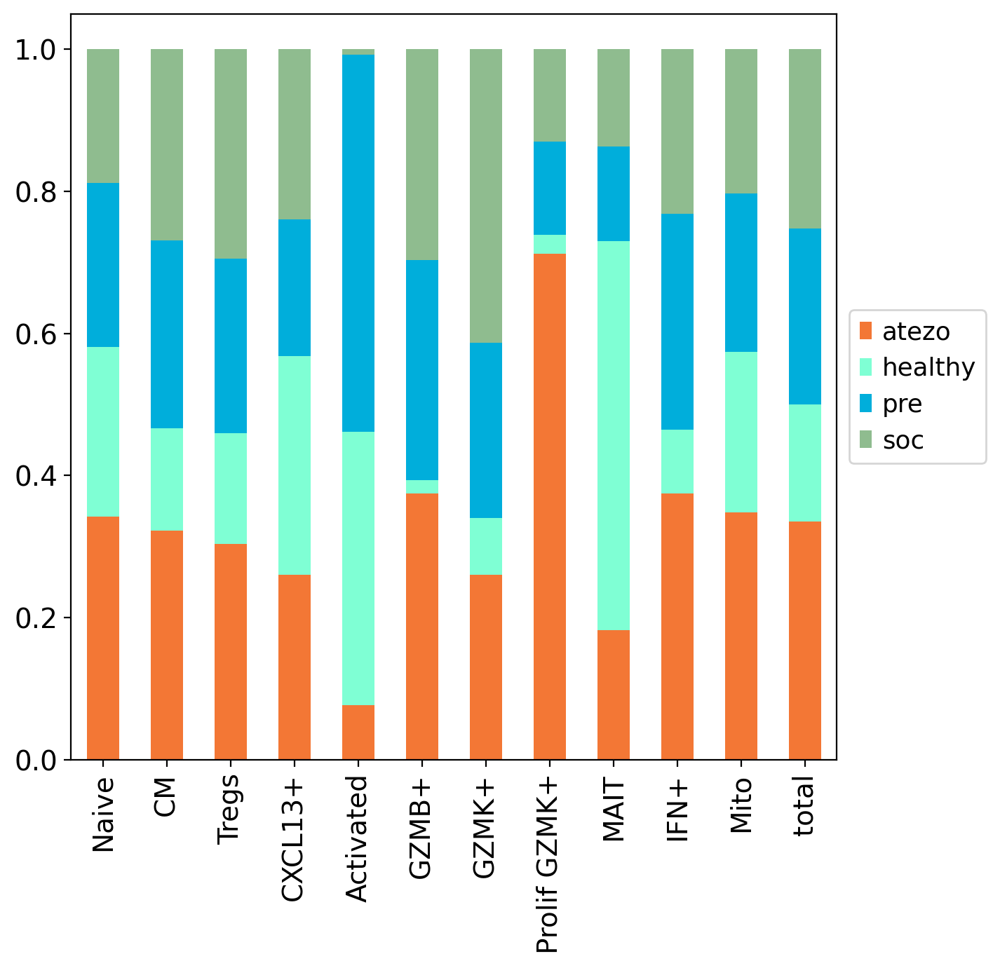

In [23]:
leiden_prop['total'] = leiden_prop.sum(axis = 1)
leiden_prct = pd.DataFrame()
for x in leiden_prop.columns:
    leiden_prct[x] = leiden_prop[x]/leiden_prop[x].sum()
leiden_prct = leiden_prct.sort_index()

leiden_prct.T.plot.bar(stacked=True, legend = False,figsize=(7,7), 
                       color = treatment_color, grid = False)
plt.legend(loc='center left', bbox_to_anchor=(1.0, 0.5), ncol = 1)
plt.savefig("/wynton/group/fong/hyang7/bladder_blood_analysis/plots/figures/bladder_TcellOnly/TreatmentSortcluster_blood_batch_breakdown_cellCalls.pdf",
            dpi = 1000, bbox_inches='tight')

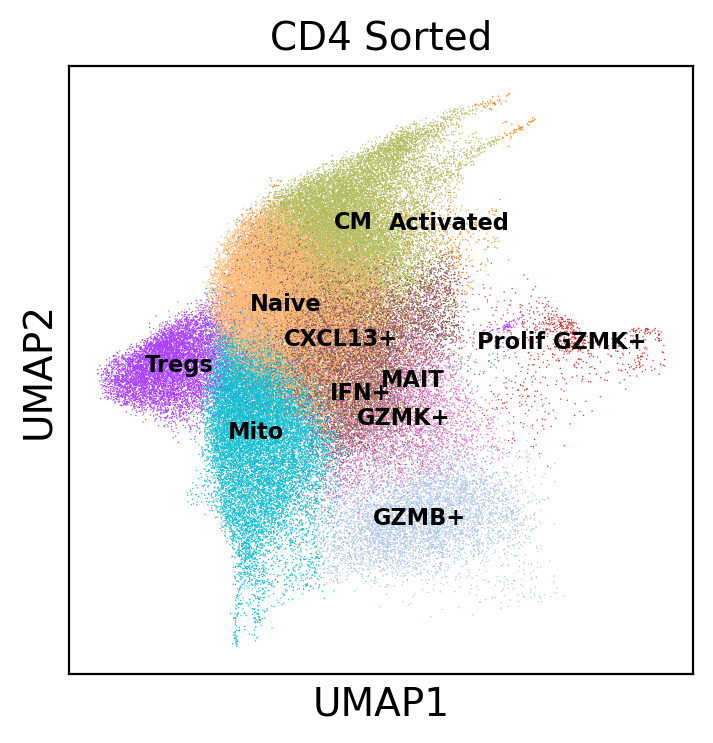

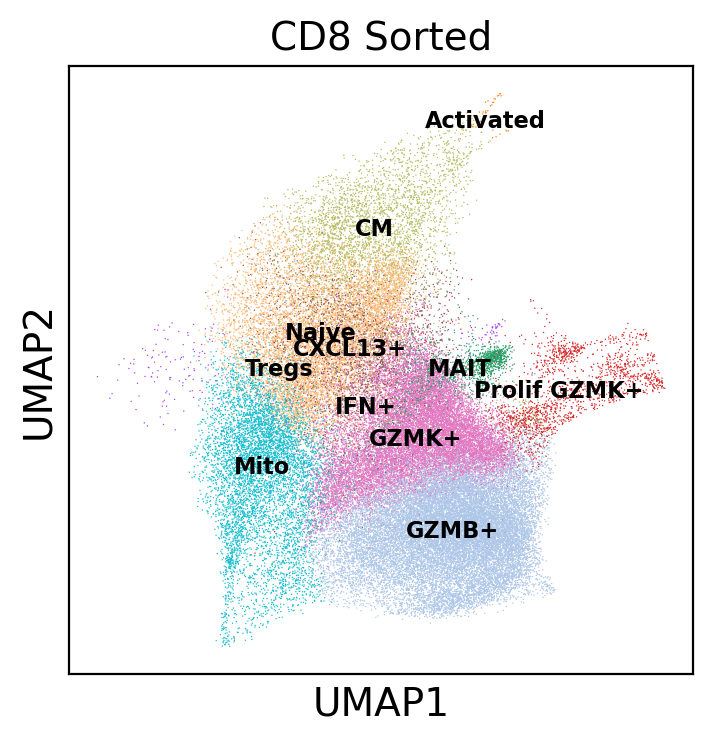

In [17]:
for cell in adata.obs['comp'].unique():
    fn = "_cellcalls_" + cell + "_sorted.pdf"
    sc.pl.umap(adata[adata.obs['comp'] == cell], 
                color = 'cell_calls', title = cell+" Sorted", 
               legend_loc = 'on data', legend_fontsize = 'xx-small', size = 1,
                save = fn)

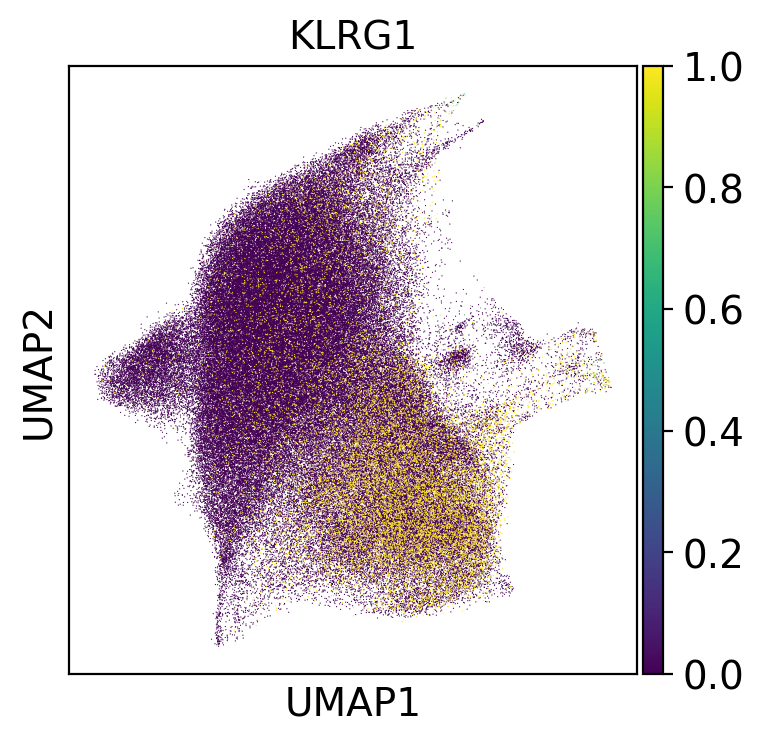

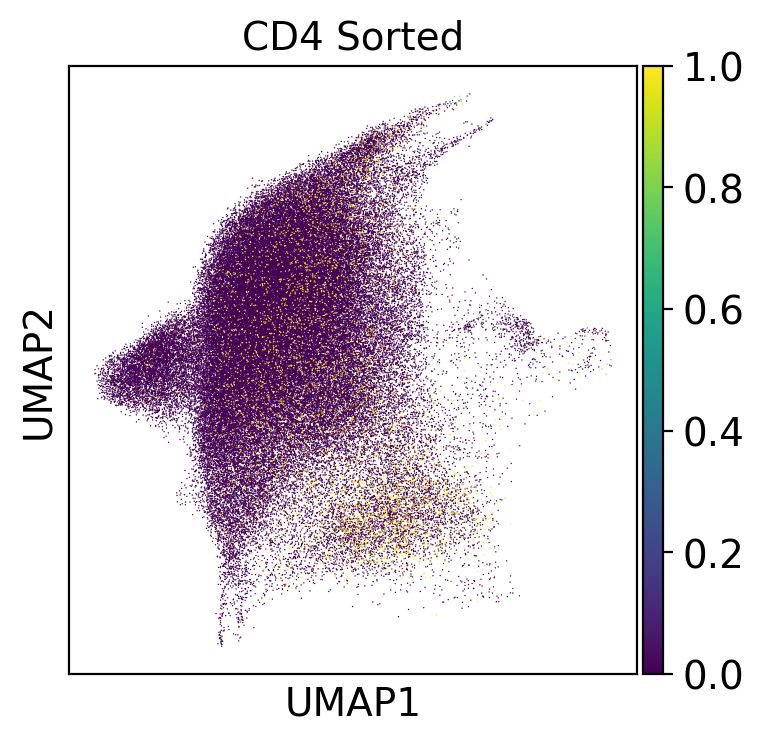

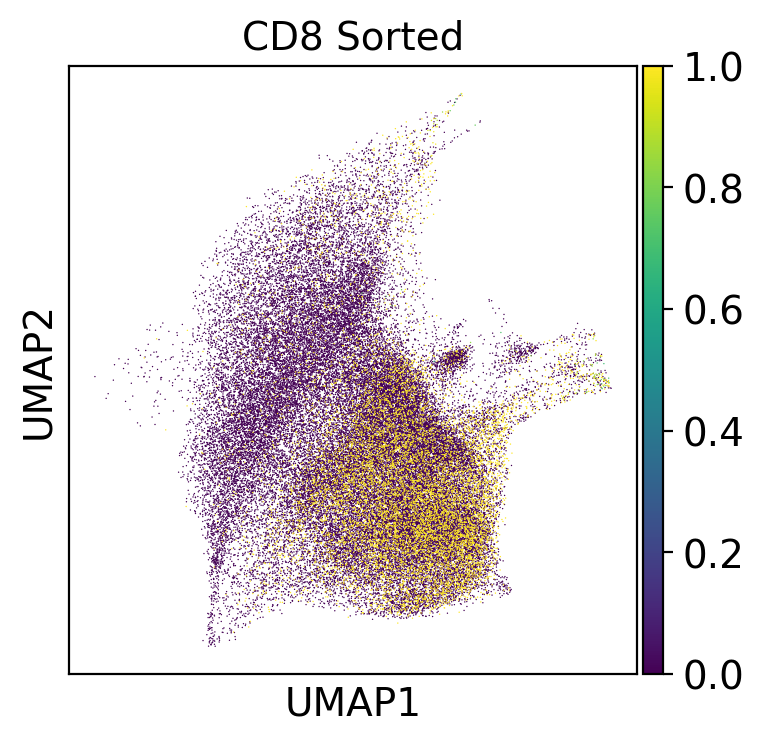

In [25]:
sc.pl.umap(adata, color = "KLRG1", vmax = 1, save = "_KLRG1+.pdf")
for cell in adata.obs['comp'].unique():
    fn = "_" + cell + "_sorted_KLRG1+.pdf"
    sc.pl.umap(adata[adata.obs['comp'] == cell], vmax = 1,
                color = 'KLRG1', title = cell+" Sorted", size = 1,
                save = fn)

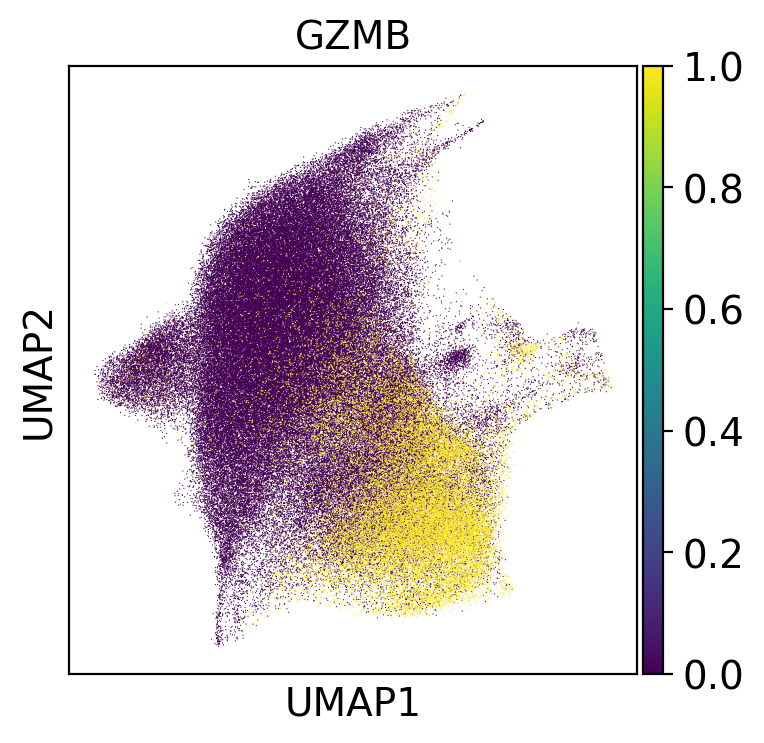

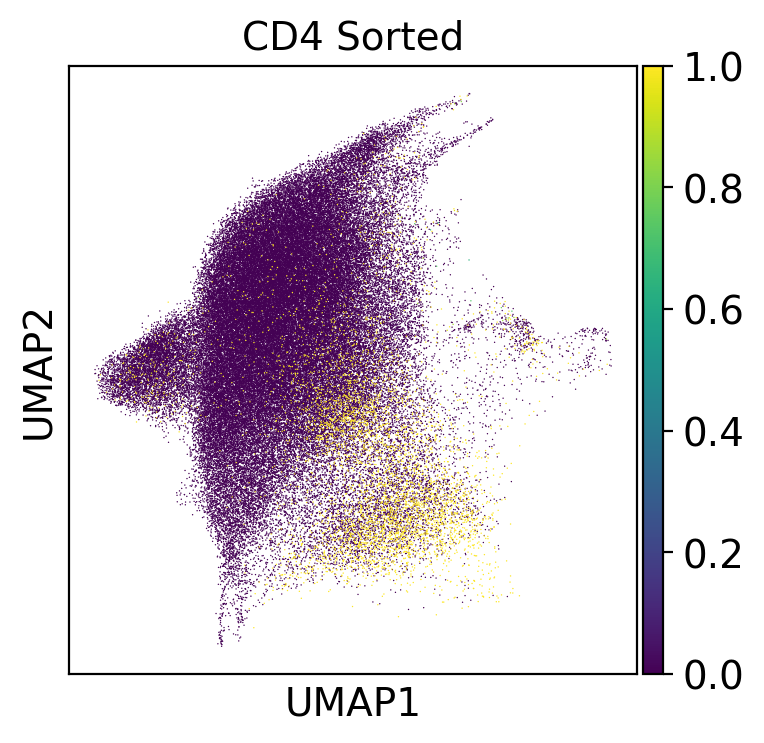

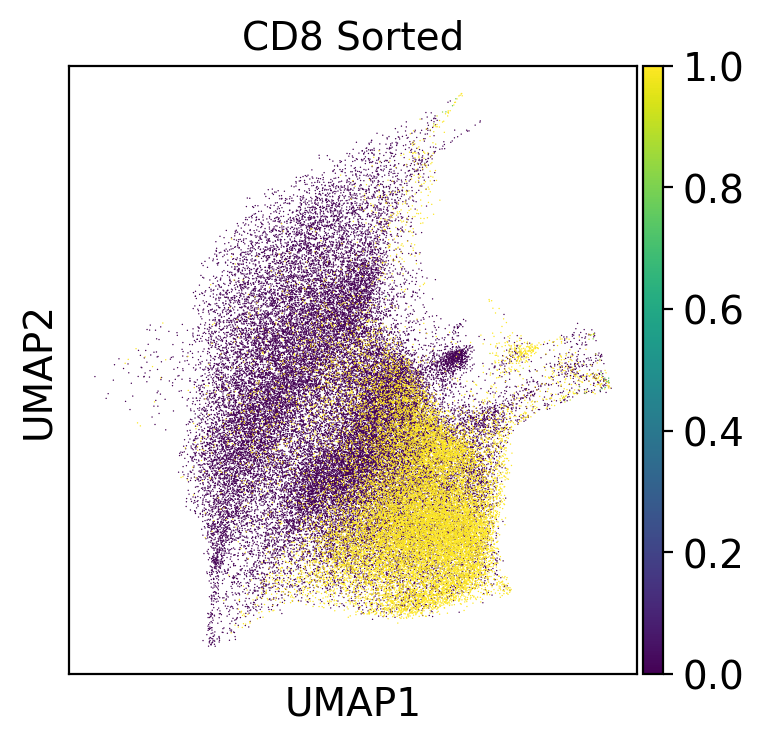

In [13]:
sc.pl.umap(adata, color = "GZMB", vmax = 1, save = "_GZMB+.pdf")
for cell in adata.obs['comp'].unique():
    fn = "_" + cell + "_sorted_GZMB+.pdf"
    sc.pl.umap(adata[adata.obs['comp'] == cell], vmax = 1,
                color = 'GZMB', title = cell+" Sorted", size = 1,
                save = fn)

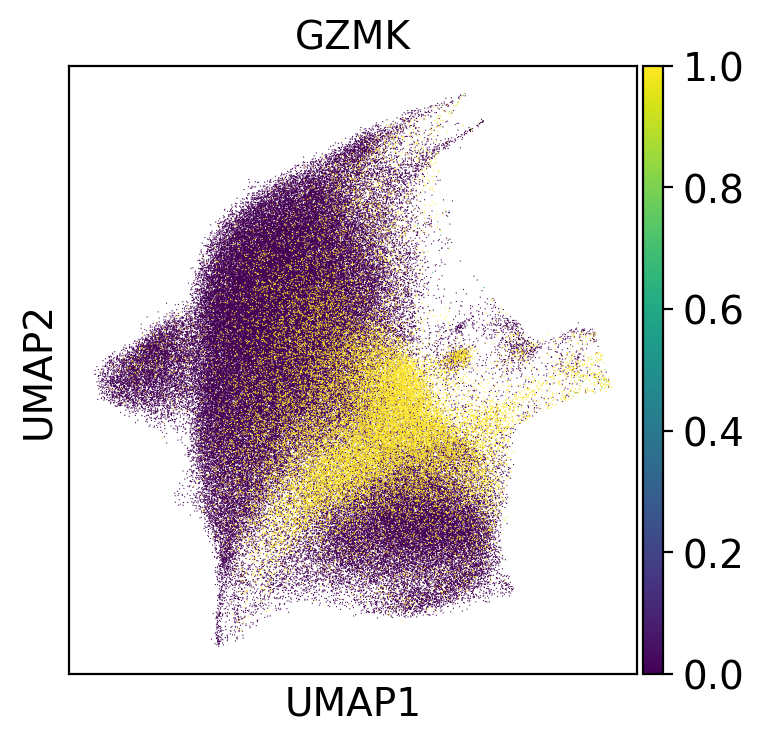

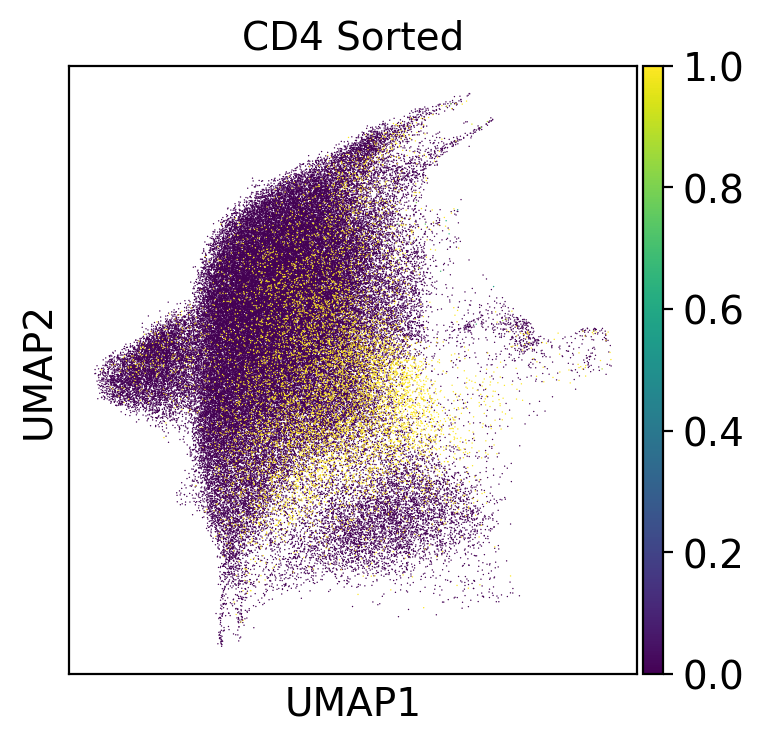

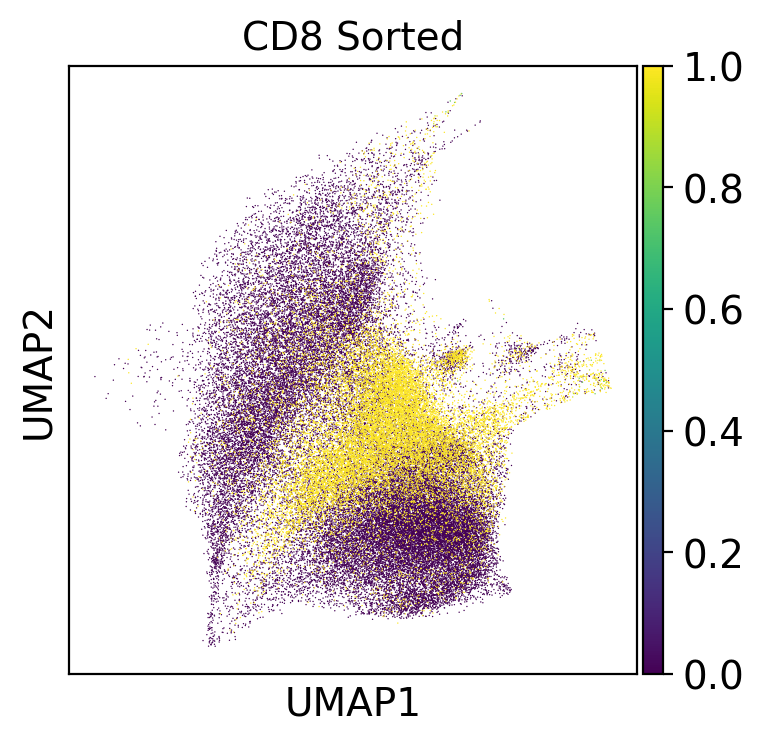

In [14]:
sc.pl.umap(adata, color = "GZMK", vmax = 1, save = "_GZMK+.pdf")
for cell in adata.obs['comp'].unique():
    fn = "_" + cell + "_sorted_GZMK+.pdf"
    sc.pl.umap(adata[adata.obs['comp'] == cell], vmax = 1,
                color = 'GZMK', title = cell+" Sorted", size = 1,
                save = fn)

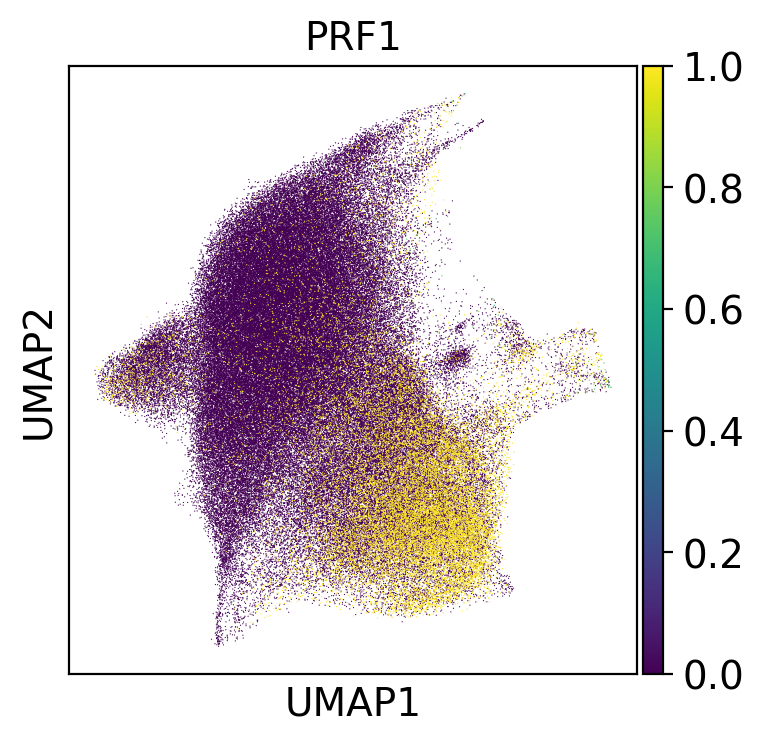

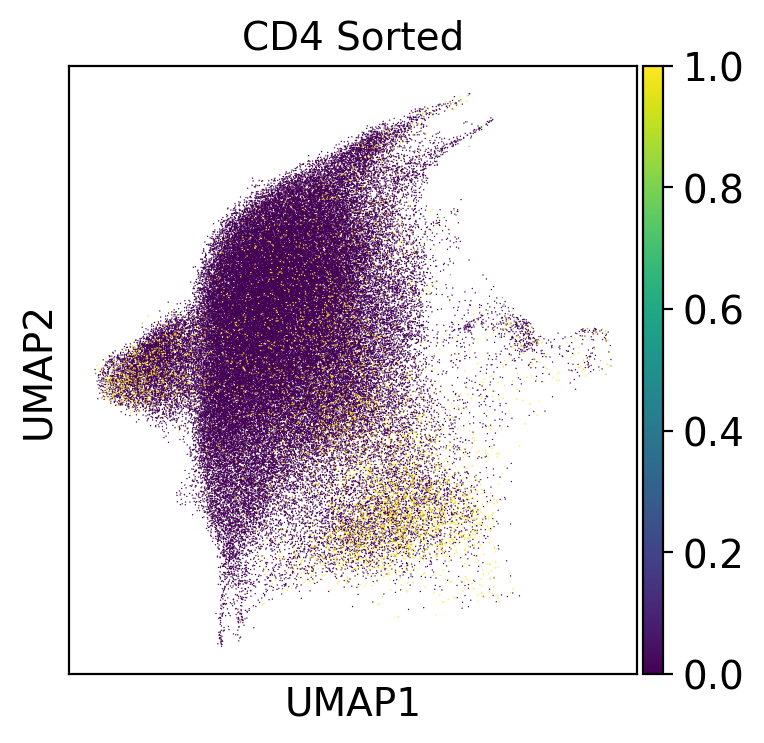

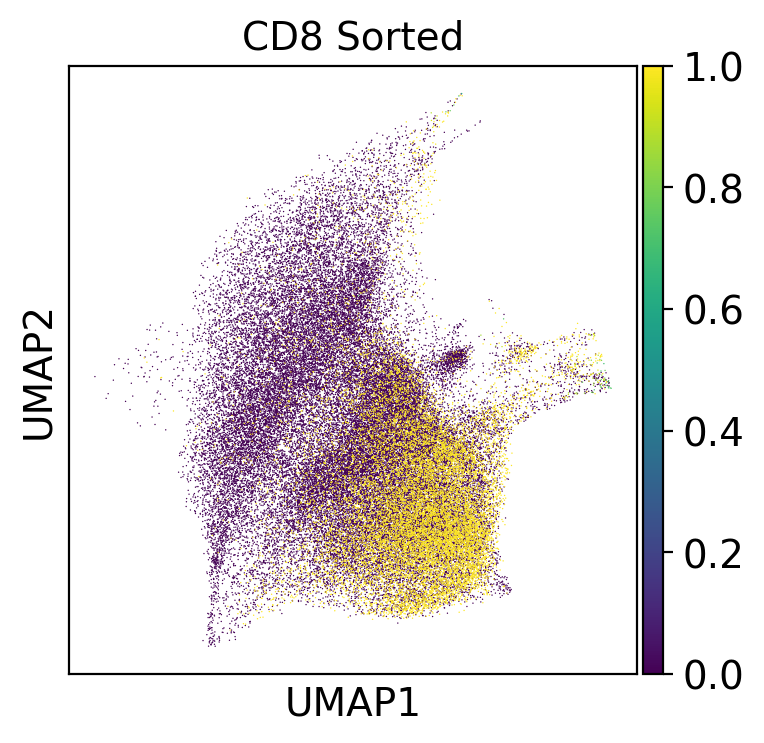

In [15]:
sc.pl.umap(adata, color = "PRF1", vmax = 1, save = "_PRF1+.pdf")
for cell in adata.obs['comp'].unique():
    fn = "_" + cell + "_sorted_PRF1+.pdf"
    sc.pl.umap(adata[adata.obs['comp'] == cell], vmax = 1,
                color = 'PRF1', title = cell+" Sorted", size = 1,
                save = fn)

In [16]:
os.getcwd()

'/wynton/group/fong/hyang7/bladder_blood_analysis/plots'

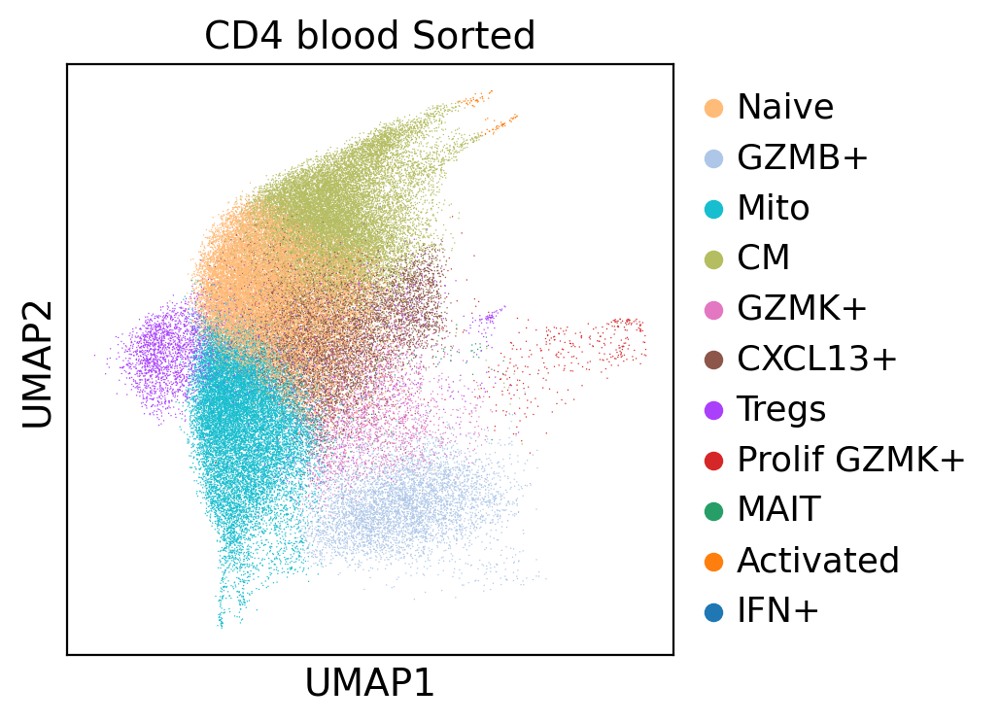

In [21]:
sc.pl.umap(adata[(adata.obs['comp'] == "CD4") & ((adata.obs['tissue'] == "blood"))], vmax = 1,
                color = ['cell_calls'], title = "CD4 blood Sorted", size = 1,
                save = '_CD4_blood_cellcalls_on_data.pdf')

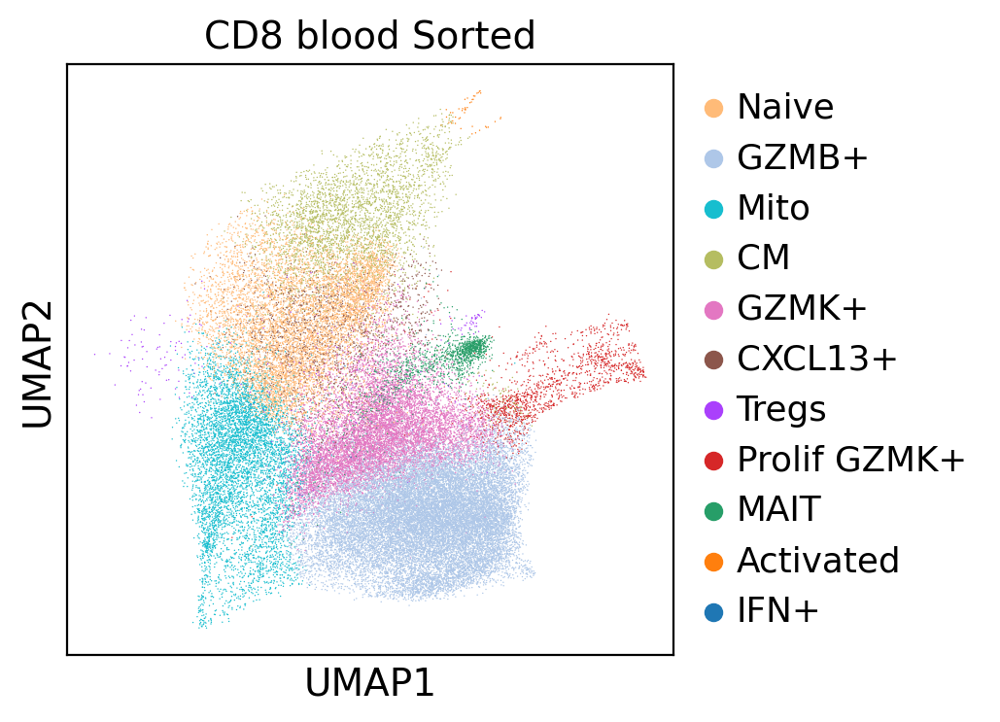

In [22]:
sc.pl.umap(adata[(adata.obs['comp'] == "CD8") & ((adata.obs['tissue'] == "blood"))], vmax = 1,
                color = ['cell_calls'], title = "CD8 blood Sorted", size = 1,
                save = '_CD8_blood_cellcalls_on_data.pdf')

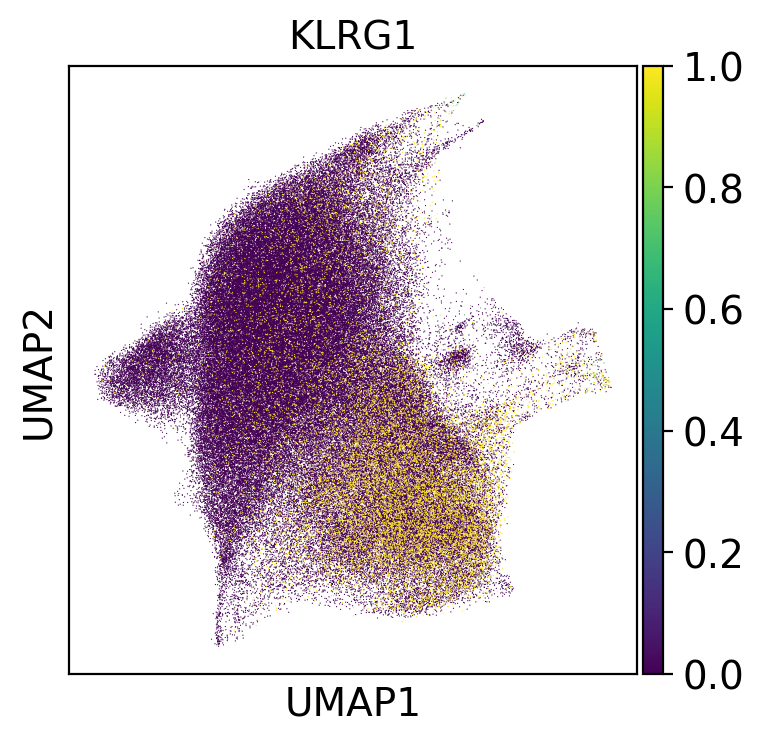

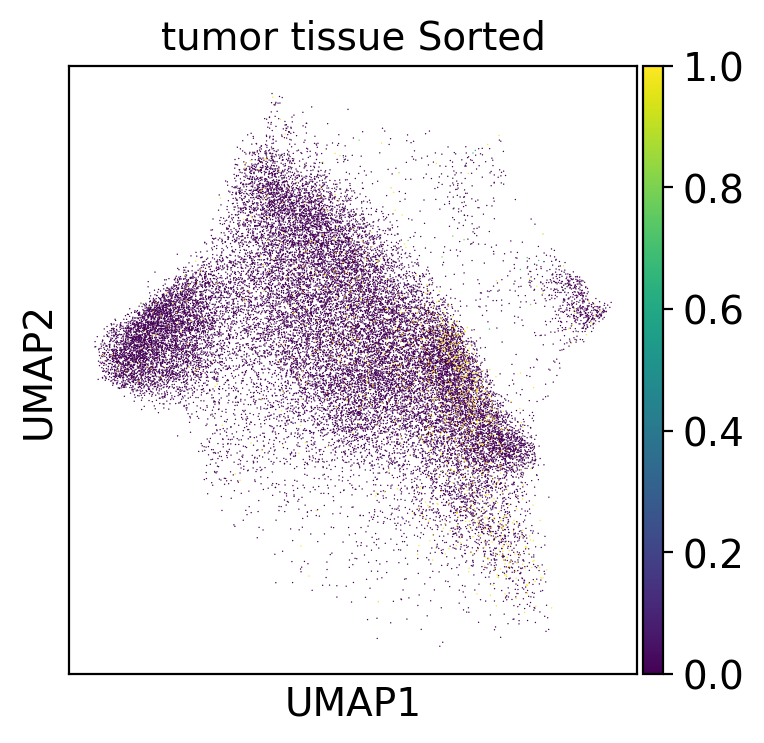

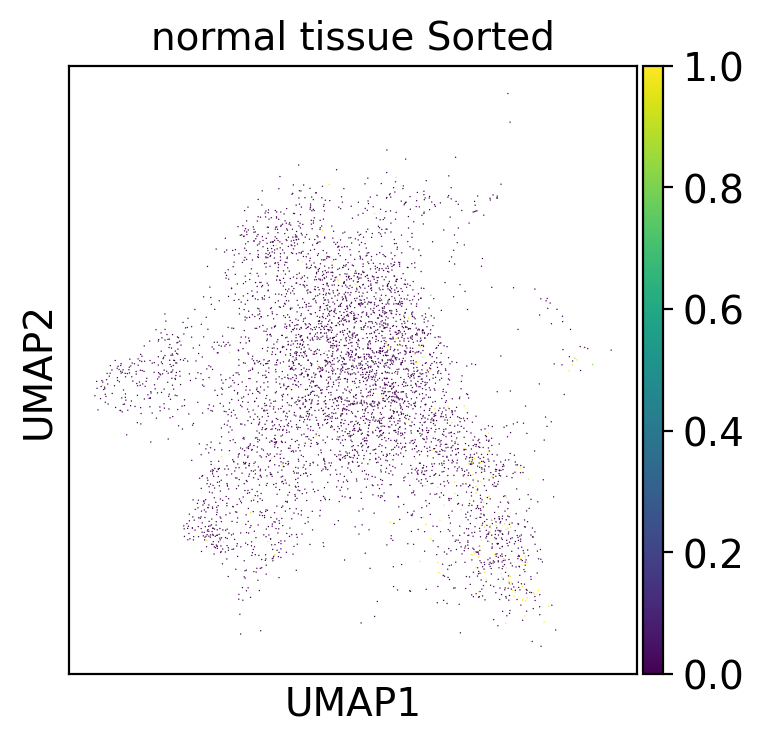

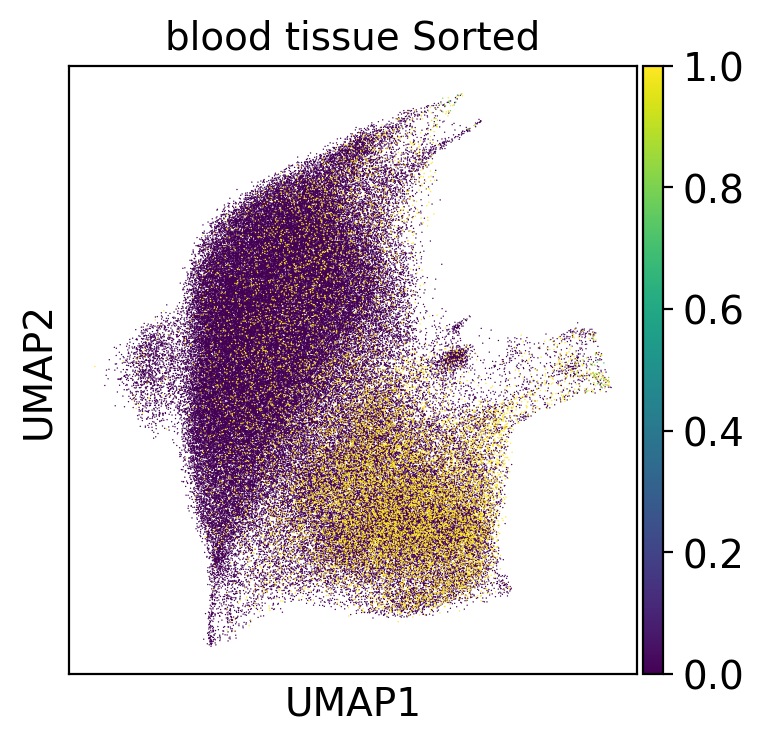

In [26]:
sc.pl.umap(adata, color = "KLRG1", vmax = 1, save = "_KLRG1+_tissue.pdf")
for cell in adata.obs['tissue'].unique():
    fn = "_" + cell + "_sorted_tissue_KLRG1+.pdf"
    sc.pl.umap(adata[adata.obs['tissue'] == cell], vmax = 1,
                color = 'KLRG1', title = cell+" tissue Sorted", size = 1,
                save = fn)

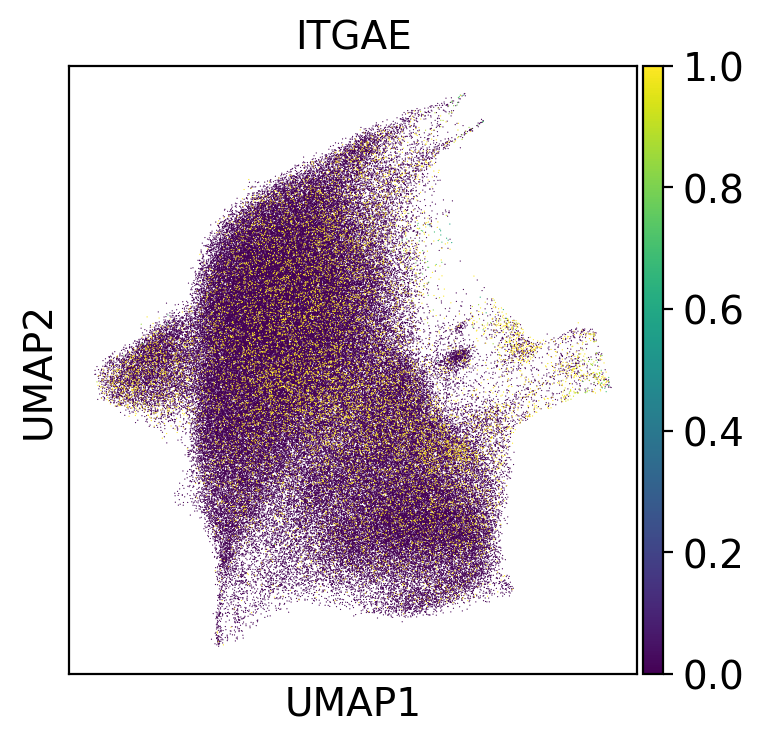

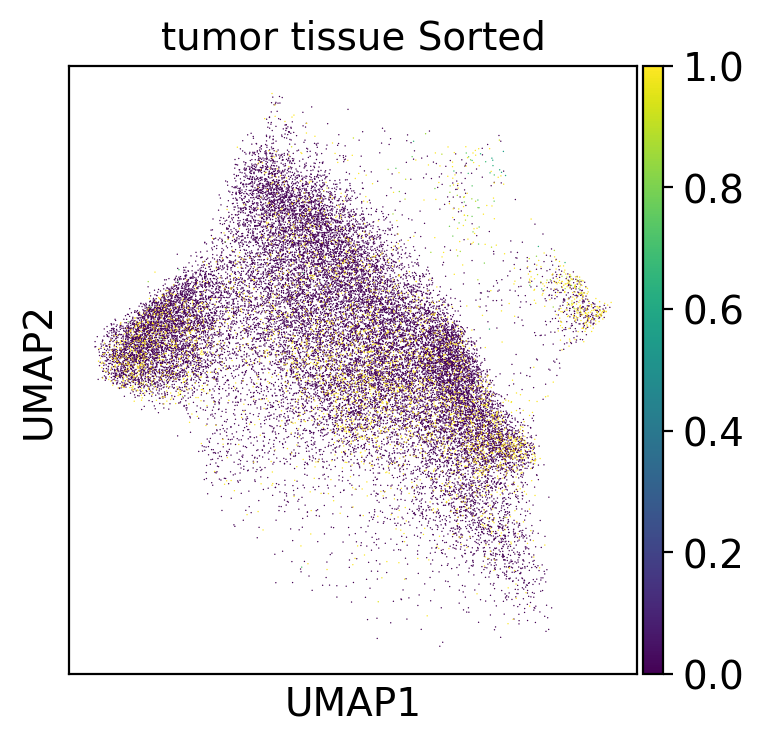

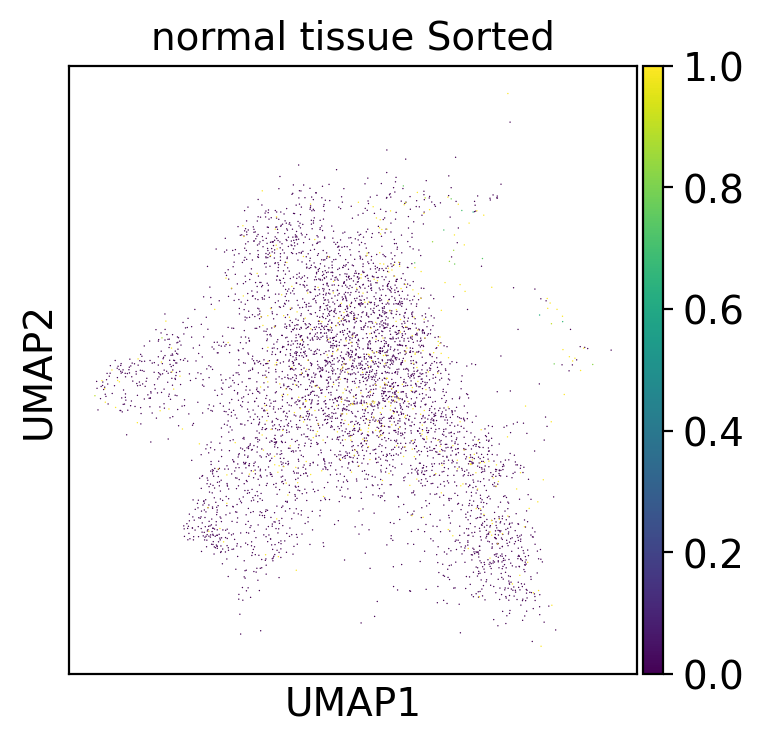

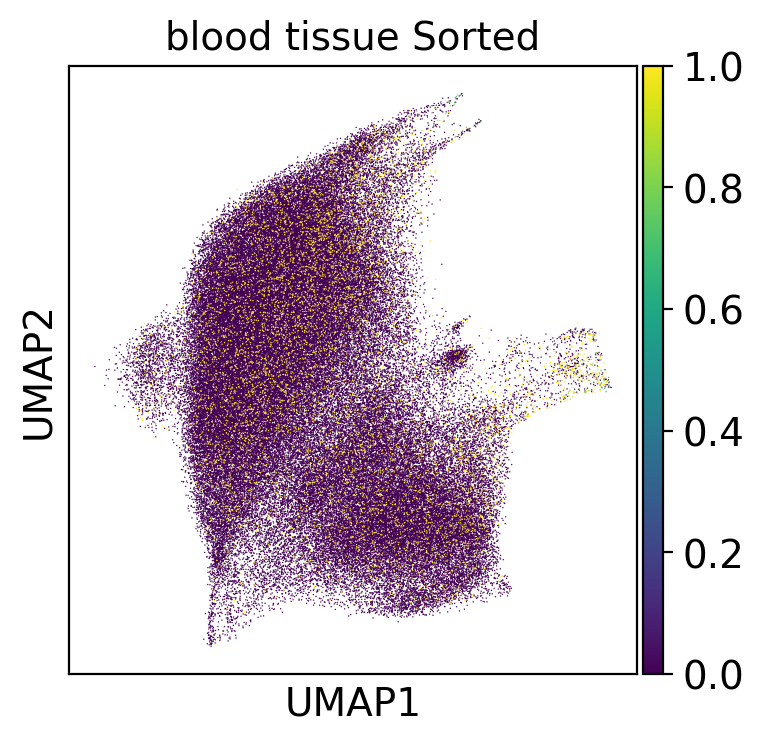

In [27]:
sc.pl.umap(adata, color = "ITGAE", vmax = 1, save = "_ITGAE+_tissue.pdf")
for cell in adata.obs['tissue'].unique():
    fn = "_" + cell + "_sorted_tissue_ITGAE+.pdf"
    sc.pl.umap(adata[adata.obs['tissue'] == cell], vmax = 1,
                color = 'ITGAE', title = cell+" tissue Sorted", size = 1,
                save = fn)

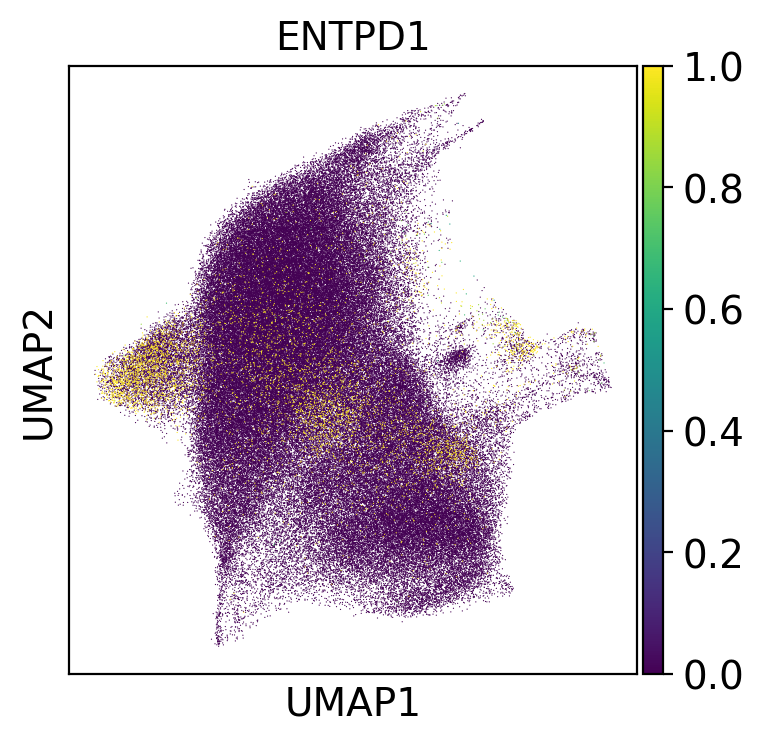

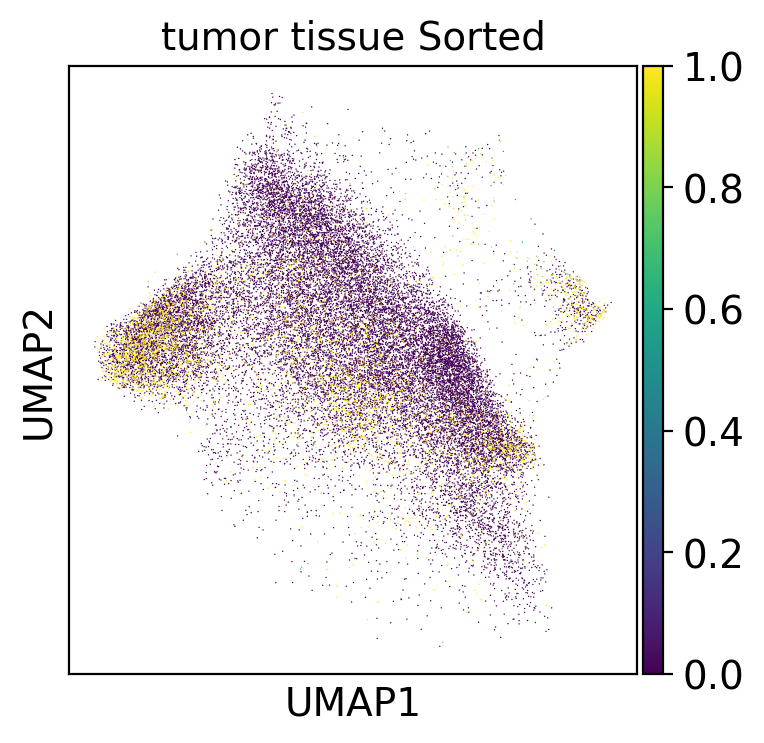

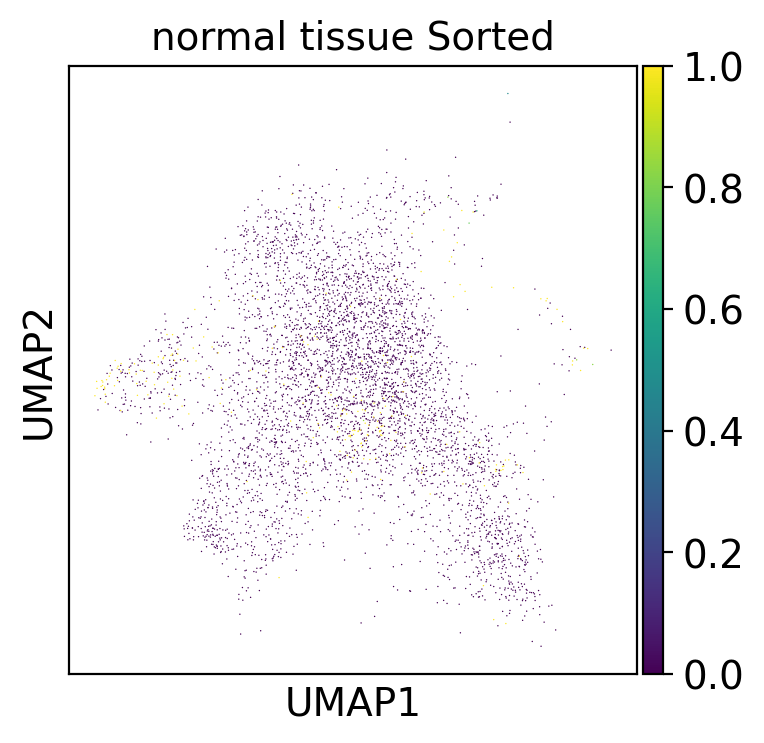

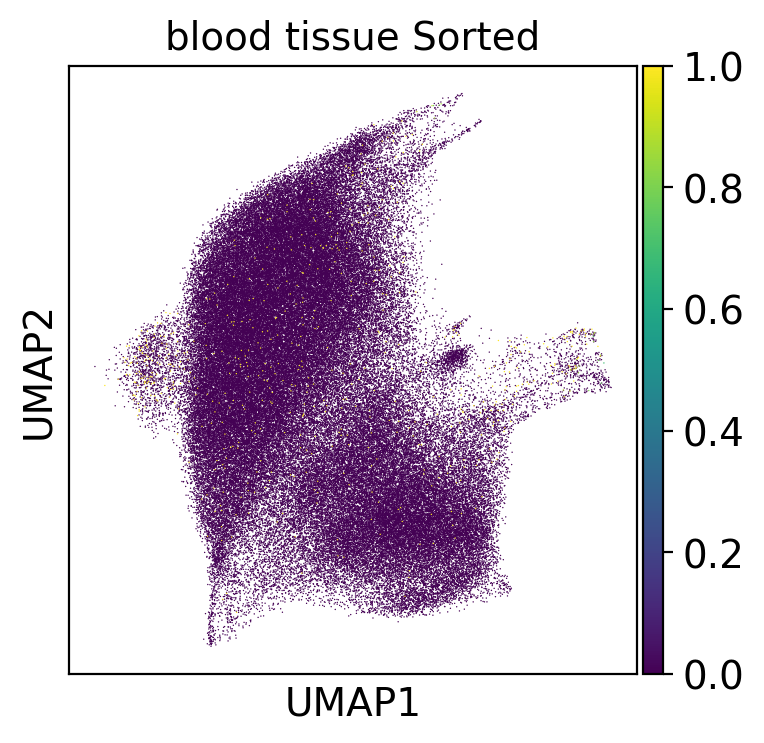

In [28]:
sc.pl.umap(adata, color = "ENTPD1", vmax = 1, save = "_ENTPD1+_tissue.pdf")
for cell in adata.obs['tissue'].unique():
    fn = "_" + cell + "_sorted_tissue_ENTPD1+.pdf"
    sc.pl.umap(adata[adata.obs['tissue'] == cell], vmax = 1,
                color = 'ENTPD1', title = cell+" tissue Sorted", size = 1,
                save = fn)

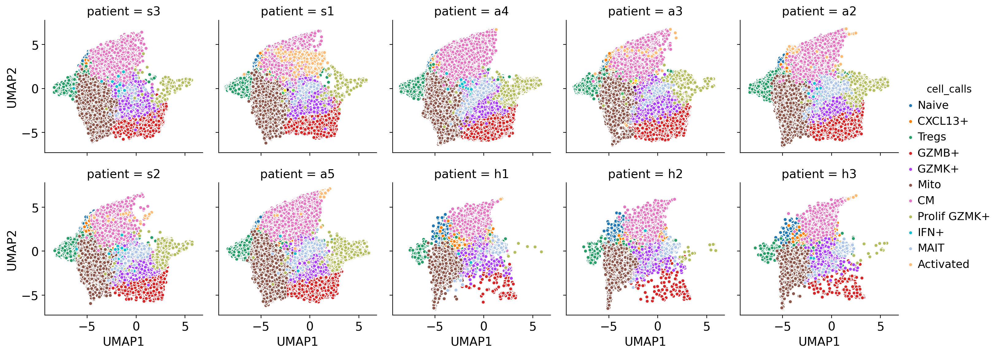

In [48]:
import matplotlib
import seaborn as sns

# matplotlib.style.use('ggplot')
plt.rcParams['axes.facecolor']="w"
plt.rcParams['axes.grid']=False
plt.rcParams['axes.edgecolor']='black'

umap_df = pd.DataFrame(adata.obsm['X_umap'])
umap_df.columns = ['UMAP1','UMAP2']
umap_df['patient'] = adata.obs['patient'].tolist()
umap_df['sample'] = adata.obs['sample'].tolist()
umap_df['comp'] = adata.obs['comp'].tolist()
umap_df['tissue'] = adata.obs['tissue'].tolist()
umap_df['treatment'] = adata.obs['treatment'].tolist()
umap_df['cell_calls'] = adata.obs['cell_calls'].tolist()

g = sns.FacetGrid(umap_df, col="patient", col_wrap = 5, hue = "cell_calls")
g = (g.map(sns.scatterplot, "UMAP1", "UMAP2", size = 0.1)
      .add_legend())
plt.savefig("/wynton/group/fong/hyang7/bladder_blood_analysis/plots/figures/bladder_TcellOnly/umap_patients_grid.pdf",
           dpi = 1000, bbox_inches = "tight", format = "pdf")

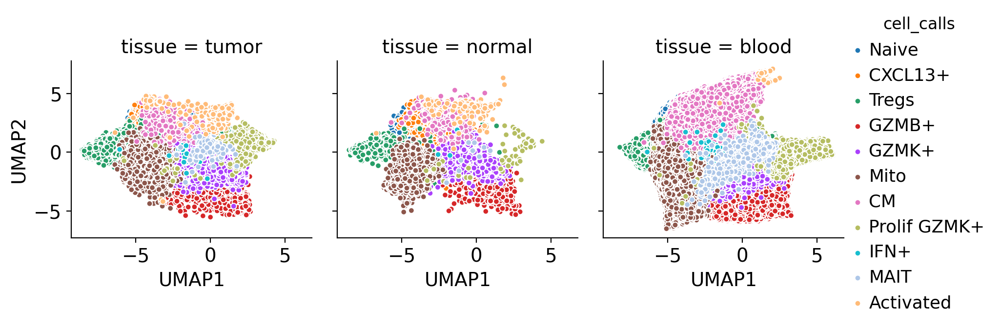

In [49]:
g = sns.FacetGrid(umap_df, col="tissue", hue = "cell_calls")
g = (g.map(sns.scatterplot, "UMAP1", "UMAP2", size = 0.1)
      .add_legend())
plt.savefig("/wynton/group/fong/hyang7/bladder_blood_analysis/plots/figures/bladder_TcellOnly/umap_tissue_grid.pdf",
           dpi = 1000, bbox_inches = "tight", format = "pdf")

In [55]:
## psuedo bulk per patient
set_genes = adata.raw.var_names

patient = np.unique(adata.obs['patient'])
psuedo_bladder = pd.DataFrame(index = list(set_genes), columns = patient)

for p in np.unique(adata.obs['patient']):
    temp_cluster = adata[adata.obs['patient'] == p]
    raw_df = pd.DataFrame(temp_cluster.raw.X.toarray()).T
    raw_df.columns = temp_cluster.obs.index
    raw_df.index = temp_cluster.raw.var_names
#   raw_df = raw_df.ix[list(set_genes)]
    raw_df = raw_df.loc[list(set_genes),]
    psuedo_bulk = raw_df.mean(axis = 1)
    psuedo_bladder[p] = psuedo_bulk

psuedo_bladder.head()

,a2,a3,a4,a5,h1,h2,h3,s1,s2,s3
RP11-34P13.7,0.000000,0.000000,0.000000,0.000486,0.000000,0.000000,0.000000,0.000000,0.0,0.000000
RP11-34P13.8,0.000217,0.000079,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000
AL627309.1,0.001336,0.000818,0.000273,0.000166,0.000278,0.001267,0.000673,0.000693,0.0,0.000429
AP006222.2,0.000091,0.001891,0.000818,0.000337,0.000388,0.000613,0.000333,0.000801,0.0,0.000784
RP11-206L10.3,0.000079,0.000000,0.000062,0.000000,0.000000,0.000000,0.000302,0.000220,0.0,0.000000


In [56]:
psuedo_bladder.to_csv('/wynton/group/fong/hyang7/bladder_blood_analysis/obj/raw_data/bladder_total_adata_multiplex_Tcellonly_raw_bulkdata.csv')

In [9]:
# cell_calls = {'0':'Tnaive','1':'GZMB+ Teff','2':'Mito','3':'Tcm',
#               '4':'GZMK+ Tex','5':'CXCL13+ T','6':'Tregs',
#               '7':'Prolif GZMK+ T','8':'MAIT',
#               '9':'Activated T','10':'IFN+ T'}
cell_calls = {'0':'Naive','1':'GZMB+','2':'Mito','3':'CM',
              '4':'GZMK+','5':'CXCL13+','6':'Tregs',
              '7':'Prolif GZMK+','8':'MAIT',
              '9':'Activated','10':'IFN+'}

In [10]:
adata.obs['cell_calls'] = adata.obs['leiden'].map(cell_calls)

In [ ]:
# cell_dict = dict(zip(adata.obs['cell_calls'].unique(),adata.uns['cell_calls_colors']))
# cell_order  = ['Tnaive','Tcm','Tregs','CXCL13+ T','Activated T',
#              'GZMB+ Teff','GZMK+ Tex','Prolif GZMK+ T', 
#              'MAIT','IFN+ T','Mito']
# cell_colors = [cell_dict[x] for x in cell_order]
# cell_colors

In [12]:
adata.write(adata_file, compression = 'gzip')
adata

AnnData object with n_obs × n_vars = 157054 × 2028 
    obs: 'RBC', 'batch', 'comp', 'n_counts', 'n_genes', 'patient', 'percent_mito', 'platelet', 'sample', 'tissue', 'treatment', 'louvain', 'leiden', 'umap_density_comp', 'umap_density_treatment', 'umap_density_tissue', 'cell_calls'
    var: 'gene_ids', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'cell_calls_colors', 'comp_colors', 'dendrogram_cell_calls', 'leiden', 'louvain', 'neighbors', 'pca', 'tissue_colors', 'treatment_colors', 'umap_density_comp_params', 'umap_density_tissue_params', 'umap_density_treatment_params'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'

In [11]:
adata.obs['cell_calls'].value_counts()

Naive           34759
GZMB+           27399
Mito            23597
CM              21247
GZMK+           19371
CXCL13+         17210
Tregs            8777
Prolif GZMK+     2408
MAIT             1680
Activated         518
IFN+               88
Name: cell_calls, dtype: int64

In [13]:
cell_calls = {'0':'Tnaive','1':'GZMB+ Teff','2':'Mito','3':'Tcm',
              '4':'GZMK+ Tex','5':'CXCL13+ T','6':'Tregs',
              '7':'Prolif GZMK+ T','8':'MAIT',
              '9':'Activated T','10':'IFN+ T'}
# cell_calls = {'0':'Naive','1':'GZMB+','2':'Mito','3':'CM',
#               '4':'GZMK+','5':'CXCL13+','6':'Tregs',
#               '7':'Prolif GZMK+','8':'MAIT',
#               '9':'Activated','10':'IFN+'}
adata.obs['cell_calls'] = adata.obs['leiden'].map(cell_calls)

In [14]:
cell_dict = dict(zip(adata.obs['cell_calls'].unique(),adata.uns['cell_calls_colors']))
cell_order  = ['Tnaive','Tcm','Tregs','CXCL13+ T','Activated T',
             'GZMB+ Teff','GZMK+ Tex','Prolif GZMK+ T', 
             'MAIT','IFN+ T','Mito']
cell_colors = [cell_dict[x] for x in cell_order]
cell_colors

['#ffbb78',
 '#aa40fc',
 '#17becf',
 '#aec7e8',
 '#1f77b4',
 '#b5bd61',
 '#e377c2',
 '#d62728',
 '#ff7f0e',
 '#279e68',
 '#8c564b']

# bladder_DEG_clustering_proj01.py

In [3]:
path = "/wynton/group/fong/hyang7/bladder_blood_analysis/obj/"
adata_file = path + "bladder_total_adata_multiplex_Tcellonly.h5ad"
# run next code to load data
adata = sc.read(adata_file)
print(adata)

AnnData object with n_obs × n_vars = 157054 × 2028 
    obs: 'RBC', 'batch', 'comp', 'n_counts', 'n_genes', 'patient', 'percent_mito', 'platelet', 'sample', 'tissue', 'treatment', 'louvain', 'leiden', 'umap_density_comp', 'umap_density_treatment', 'umap_density_tissue', 'cell_calls', 'S_score', 'G2M_score', 'phase'
    var: 'gene_ids', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'batch_colors', 'cell_calls_colors', 'comp_colors', 'dendrogram_cell_calls', 'leiden', 'leiden_colors', 'louvain', 'louvain_colors', 'neighbors', 'pca', 'phase_colors', 'tissue_colors', 'treatment_colors', 'umap_density_comp_params', 'umap_density_tissue_params', 'umap_density_treatment_params'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'


In [4]:
adata.obs['leiden'].unique()

[0, 5, 6, 1, 4, ..., 3, 7, 10, 8, 9]
Length: 11
Categories (11, object): [0, 5, 6, 1, ..., 7, 10, 8, 9]

In [6]:
adata.obs['cell_calls'].value_counts()

Naive           34759
GZMB+           27399
Mito            23597
CM              21247
GZMK+           19371
CXCL13+         17210
Tregs            8777
Prolif GZMK+     2408
MAIT             1680
Activated         518
IFN+               88
Name: cell_calls, dtype: int64

In [7]:
# add by HY
#Calculate marker genes
sc.tl.rank_genes_groups(adata, groupby='cell_calls', key_added='rank_genes_cell_calls')

ranking genes
    finished: added to `.uns['rank_genes_cell_calls']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:42)


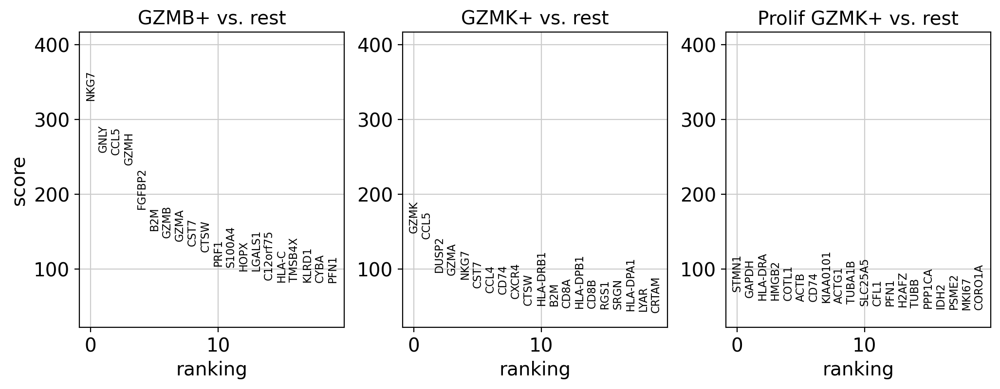

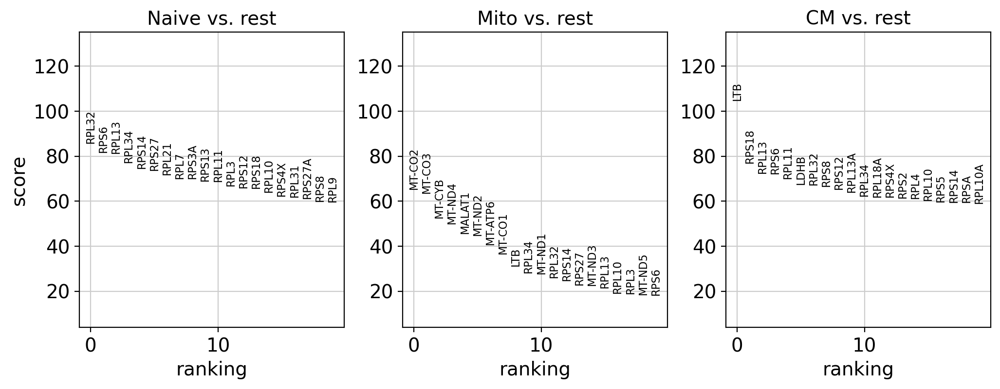

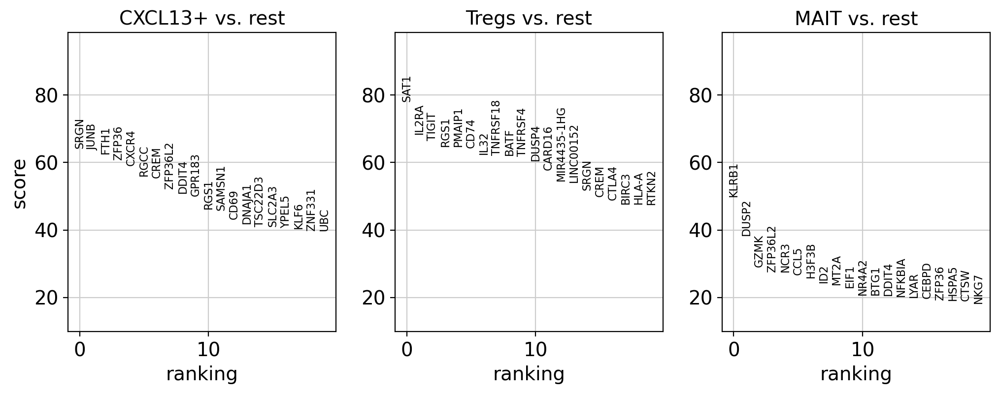

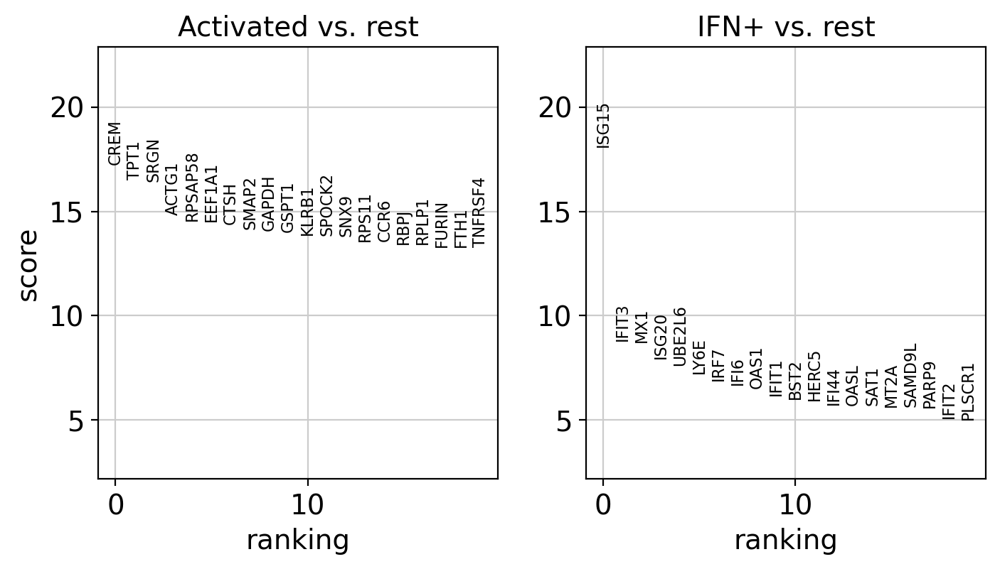

In [15]:
# #Plot marker genes
sc.pl.rank_genes_groups(adata, key='rank_genes_cell_calls', groups=['GZMB+','GZMK+','Prolif GZMK+'])
sc.pl.rank_genes_groups(adata, key='rank_genes_cell_calls', groups=['Naive','Mito','CM'])
sc.pl.rank_genes_groups(adata, key='rank_genes_cell_calls', groups=['CXCL13+','Tregs','MAIT'])
sc.pl.rank_genes_groups(adata, key='rank_genes_cell_calls', groups=['Activated','IFN+'])

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:41)


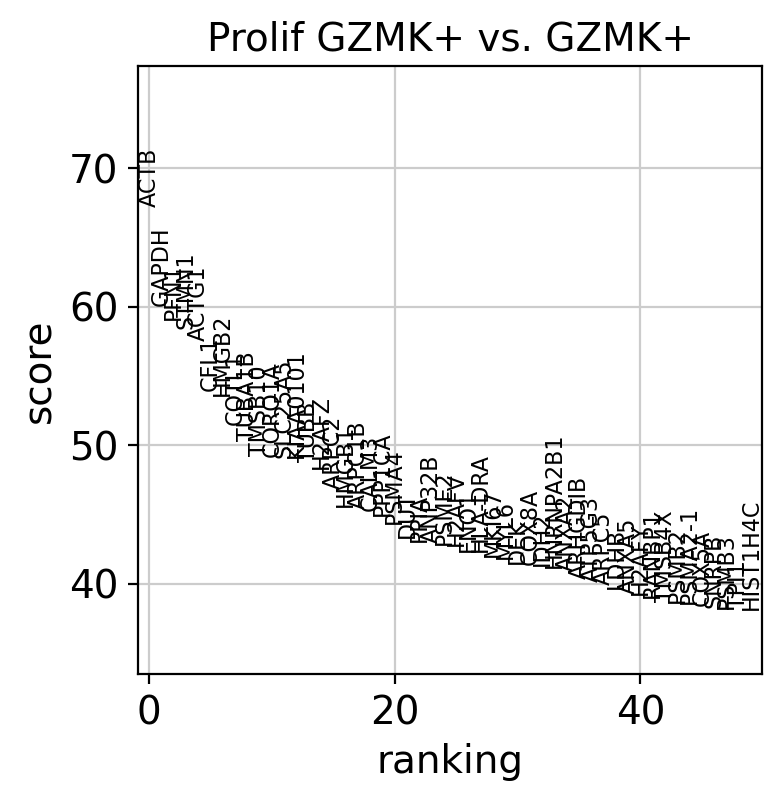

In [18]:
# Compare to a single cluster.
sc.tl.rank_genes_groups(adata, 'cell_calls', groups=['Prolif GZMK+'], reference='GZMK+', method='wilcoxon') 


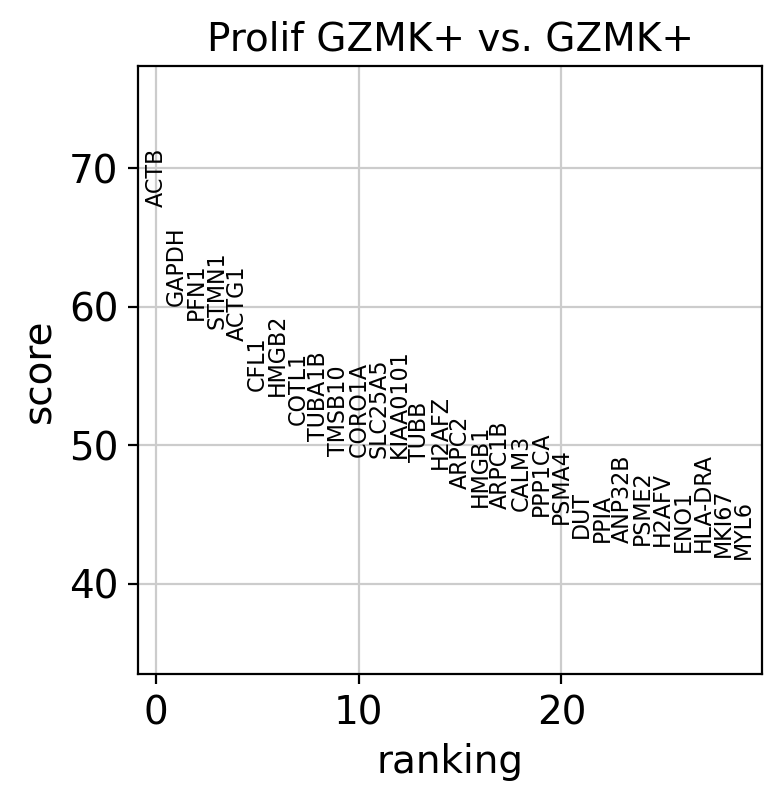

In [19]:
sc.pl.rank_genes_groups(adata, groups=['Prolif GZMK+'], n_genes=30)

In [25]:
sc.tl.rank_genes_groups(adata, 'cell_calls', group = "all" , reference = "rest", 
			use_raw=True,n_genes=1000, rankby_abs=False, key_added=None,
                        copy=False, method='wilcoxon',
                        corr_method='benjamini-hochberg', log_transformed=True, only_positive = True)

result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
df = pd.DataFrame(
    {group + '_' + key: result[key][group]
    for group in groups for key in ['names','logfoldchanges', 'pvals_adj']})
df.to_csv("/wynton/group/fong/hyang7/bladder_blood_analysis/obj/bladder_total_TcellOnly_cell_calls_rank_genes_group.csv", index = False)
#adata.write(adata_file, compression = "gzip")

for cell in adata.obs['comp'].unique():
    temp_adata = adata[adata.obs['comp'] == cell]
    sc.tl.rank_genes_groups(temp_adata, 'cell_calls', group = "all" , 
                        reference = "rest",use_raw=True,n_genes=1000, rankby_abs=False, key_added=None,
                        copy=False, method='wilcoxon',
                        corr_method='benjamini-hochberg', log_transformed=True, only_positive = True)

    result = temp_adata.uns['rank_genes_groups']
    groups = result['names'].dtype.names
    df = pd.DataFrame(
        {group + '_' + key: result[key][group]
        for group in groups for key in ['names','logfoldchanges', 'pvals_adj']})
    df.to_csv("/wynton/group/fong/hyang7/bladder_blood_analysis/obj/bladder_total_"+cell+"TcellOnly_cell_calls_rank_genes_group.csv", index = False)
    del temp_adata


AnnData object with n_obs × n_vars = 157054 × 2028 
    obs: 'RBC', 'batch', 'comp', 'n_counts', 'n_genes', 'patient', 'percent_mito', 'platelet', 'sample', 'tissue', 'treatment', 'louvain', 'leiden', 'umap_density_comp', 'umap_density_treatment', 'umap_density_tissue', 'cell_calls'
    var: 'gene_ids', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'comp_colors', 'leiden', 'louvain', 'neighbors', 'pca', 'tissue_colors', 'treatment_colors', 'umap_density_comp_params', 'umap_density_tissue_params', 'umap_density_treatment_params'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:04:23)
ra

# CD4_CD8_cellPopcomparisons.ipynb

In [61]:
path = "/wynton/group/fong/hyang7/bladder_blood_analysis/obj/"
adata_file = path + "bladder_total_adata_multiplex_Tcellonly.h5ad"
# adata = sc.read(adata_file)
adata

AnnData object with n_obs × n_vars = 157054 × 2028 
    obs: 'RBC', 'batch', 'comp', 'n_counts', 'n_genes', 'patient', 'percent_mito', 'platelet', 'sample', 'tissue', 'treatment', 'louvain', 'leiden', 'umap_density_comp', 'umap_density_treatment', 'umap_density_tissue', 'cell_calls'
    var: 'gene_ids', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'comp_colors', 'leiden', 'louvain', 'neighbors', 'pca', 'tissue_colors', 'treatment_colors', 'umap_density_comp_params', 'umap_density_tissue_params', 'umap_density_treatment_params', 'cell_calls_colors', 'dendrogram_cell_calls'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'

In [62]:
len_genes = len(adata.raw.var_names)
final_df = pd.DataFrame()

for cell in np.unique(adata.obs['cell_calls']):
    print("Performing DE on {} type".format(cell))
    cell_adata = adata[adata.obs['cell_calls'] == cell]
    try:
        sc.tl.rank_genes_groups(cell_adata, "comp", use_raw = True, groups = ['CD4'],
                                reference = 'CD8', n_genes = len_genes, 
                               copy=False, method='wilcoxon',
                                corr_method='benjamini-hochberg', log_transformed=True)
        result = cell_adata.uns['rank_genes_groups']
        groups = result['names'].dtype.names
        de_df = pd.DataFrame(
                {group + '_' + key: result[key][group]
                for group in groups for key in ['names','logfoldchanges','pvals_adj']})
        de_df = de_df[de_df['CD4_pvals_adj'] < 0.05] # keep only signficant genes
        de_df['cell_type'] = [cell] * de_df.shape[0]
        final_df = final_df.append(de_df, ignore_index = True)
        print("Finished DE on {} type".format(cell))
    except:
        print("No {} type observed in object".format(cell))
    del cell_adata

Performing DE on Activated type
ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
Finished DE on Activated type
Performing DE on CM type
ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:26)
Finished DE on CM type
Performing DE on CXCL13+ type
ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.reca

In [64]:
final_df.to_csv("../analysis/DEG/cellSort_TcellOnly_CD4vCD8_DEG_results.csv", 
                index = False)

In [65]:
df = pd.DataFrame(adata.obs[['patient','comp','cell_calls']])
df['tag'] = df['patient'].astype(str) + ';' + df['comp'].astype(str) + ";" + df['cell_calls'].astype(str)
df.head()

,patient,comp,cell_calls,tag
index,,,,
AAACATTGCTTGGA-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,s3,CD4,Naive,s3;CD4;Naive
AAACCGTGCACCAA-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,s3,CD4,CXCL13+,s3;CD4;CXCL13+
AAACCGTGTGCCCT-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,s3,CD4,Tregs,s3;CD4;Tregs
AAACGGCTCCTTGC-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,s3,CD4,GZMB+,s3;CD4;GZMB+
AAACGGCTGTCTAG-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,s3,CD4,CXCL13+,s3;CD4;CXCL13+


In [66]:
df_counts = pd.DataFrame(df['tag'].value_counts())
df_counts.columns = ['count']
df_counts['tag'] = df_counts.index
df_counts[['patient','comp','cell_calls']] = df_counts['tag'].str.split(';',expand=True)
df_counts['Sample_ID'] = df_counts['patient'] + "_" + df_counts['comp']
df_counts['log_count'] = np.log2(df_counts['count'])

In [67]:
dict_totals = df_counts.groupby(['Sample_ID']).aggregate({'count':'sum'}).to_dict()['count']
df_counts['total'] = df_counts['Sample_ID'].map(dict_totals)
df_counts['cell_prct'] = df_counts['count']/df_counts['total']

In [68]:
df_counts.head()

,count,tag,patient,comp,cell_calls,Sample_ID,log_count,total,cell_prct
a4;CD4;Naive,5403,a4;CD4;Naive,a4,CD4,Naive,a4_CD4,12.399545,18184,0.297129
a4;CD8;GZMB+,4831,a4;CD8;GZMB+,a4,CD8,GZMB+,a4_CD8,12.238106,11796,0.409546
a4;CD4;CM,4270,a4;CD4;CM,a4,CD4,CM,a4_CD4,12.060020,18184,0.234822
a2;CD4;Naive,4124,a2;CD4;Naive,a2,CD4,Naive,a2_CD4,12.009829,12926,0.319047
s3;CD8;GZMB+,3700,s3;CD8;GZMB+,s3,CD8,GZMB+,s3_CD8,11.853310,9117,0.405835


In [69]:
df_counts.to_csv("../analysis/cellSorting_frequencyCounts.csv", index = False)

# grab_stats.ipynb

In [88]:
import pandas as pd
import glob
import os

In [ ]:
path = "/wynton/group/fong/hyang7/bladder_blood_analysis/obj/"
adata_file = path + "bladder_total_adata_multiplex_Tcellonly.h5ad"
# adata = sc.read(adata_file)
adata

In [94]:
cell_calls = {'0':'Naive','1':'GZMB+','2':'Mito','3':'CM',
              '4':'GZMK+','5':'CXCL13+','6':'Tregs',
              '7':'Prolif GZMK+','8':'MAIT',
              '9':'Activated','10':'IFN+'}

In [95]:
adata.obs['cell_calls'] = adata.obs['leiden'].map(cell_calls)

In [96]:
fn = glob.glob("/wynton/group/fong/hyang7/bladder_blood_analysis/plots/figures/bladder_TcellOnly/Statistics/cd3_total/*.csv")

In [97]:
final_df = pd.DataFrame()

for f in fn:
    temp = pd.read_csv(f)
    temp['denom'] = [f.split('/')[-2]] * temp.shape[0]
    temp['file'] = [os.path.basename(f)] * temp.shape[0]
    if 'TIL' in f:
        temp['comp'] = ['TILs'] * temp.shape[0]
    else:
        temp['comp'] = ['blood'] * temp.shape[0]
    if 'CD8' in f:
        temp['cell'] = ['CD8'] * temp.shape[0]
    else:
        temp['cell'] = ['CD4'] * temp.shape[0]
    final_df = final_df.append(temp, ignore_index = True)

In [98]:
final_df = final_df[final_df['p_adj'].notna()]
final_df = final_df.sort_values(by = ['p_adj'])

In [99]:
final_df[(final_df['p_adj'] < 0.05) & (final_df['comp'] == 'TILs')]

,Cell,F-test,R2,p_adj,denom,file,comp,cell,comparison
197,Mito,0.001098,0.900570,0.012016,cd3_total,bladderCD4_TILs_atezo_WLSstats.csv,TILs,CD4,NaN
195,MAIT,0.002031,0.873395,0.020126,cd3_total,bladderCD4_TILs_atezo_WLSstats.csv,TILs,CD4,NaN
234,CXCL13+ T,0.004608,0.532978,0.049532,cd3_total,bladderCD4_TILs_treatment_WLSstats.csv,TILs,CD4,NaN


In [100]:
final_df[(final_df['p_adj'] < 0.06) & (final_df['comp']  == 'blood')]

,Cell,F-test,R2,p_adj,denom,file,comp,cell,comparison
154,Tnaive,0.000118,0.982351,0.001292,cd3_total,bladderCD8_blood_treatment_WLSstats.csv,blood,CD8,soc_vs_healthy
140,MAIT,0.000158,0.953880,0.001734,cd3_total,bladderCD8_blood_treatment_WLSstats.csv,blood,CD8,atezo_vs_healthy
129,MAIT,0.000218,0.947519,0.002400,cd3_total,bladderCD8_blood_treatment_WLSstats.csv,blood,CD8,pre_vs_healthy
69,CXCL13+ T,0.001395,0.890775,0.015233,cd3_total,bladderCD4_blood_treatment_WLSstats.csv,blood,CD4,pre_vs_healthy
102,CXCL13+ T,0.001542,0.936560,0.016835,cd3_total,bladderCD4_blood_treatment_WLSstats.csv,blood,CD4,soc_vs_healthy
85,MAIT,0.002282,0.867477,0.024820,cd3_total,bladderCD4_blood_treatment_WLSstats.csv,blood,CD4,atezo_vs_healthy
137,GZMB+ Teff,0.002620,0.860121,0.025893,cd3_total,bladderCD8_blood_treatment_WLSstats.csv,blood,CD8,atezo_vs_healthy
74,MAIT,0.002935,0.853766,0.028968,cd3_total,bladderCD4_blood_treatment_WLSstats.csv,blood,CD4,pre_vs_healthy
80,CXCL13+ T,0.003830,0.837770,0.037646,cd3_total,bladderCD4_blood_treatment_WLSstats.csv,blood,CD4,atezo_vs_healthy
162,MAIT,0.004679,0.890417,0.045813,cd3_total,bladderCD8_blood_treatment_WLSstats.csv,blood,CD8,soc_vs_healthy
